In [12]:
import os
os.chdir('/data/l989o/deployed/a')
import sys
if '/data/l989o/a' in sys.path:
    sys.path.remove('/data/l989o/a')    

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
import math

In [14]:
scaler_train = pickle.load(open('/data/l989o/deployed/spatial_uzh/data/spatial_uzh_processed/a/scaler_train.pickle', 'rb'))

def scale(ome_filename, x):
    o = ome_filename
    q0 = scaler_train[o]['q0']
    q1 = scaler_train[o]['q1']
    t0 = x / q0
    cofactor = q1 / math.sinh(1)
    # not tested yet
    z = np.arcsinh(t0 / cofactor)
    # z = np.arcsinh(t0 / cofactor)
    return z

In [15]:
from data import OmeDataset
ds = OmeDataset('train')
ds[0].shape

torch.Size([421, 833, 39])

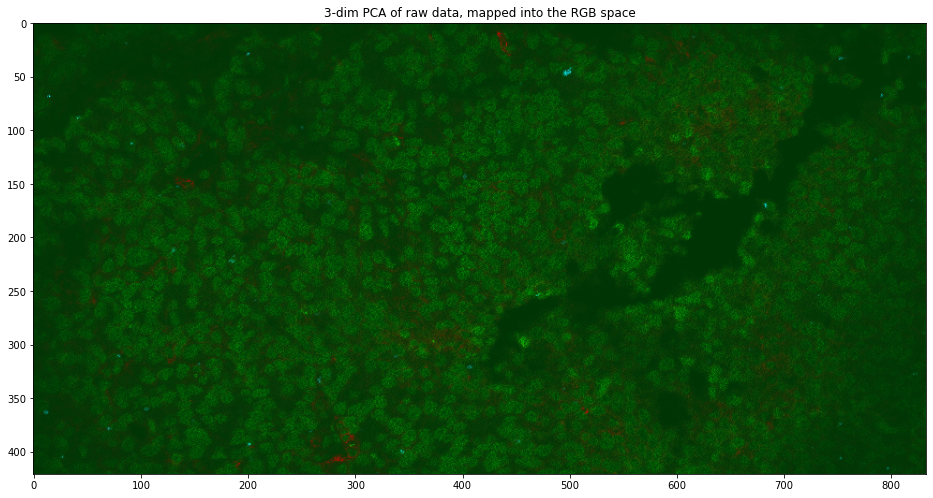

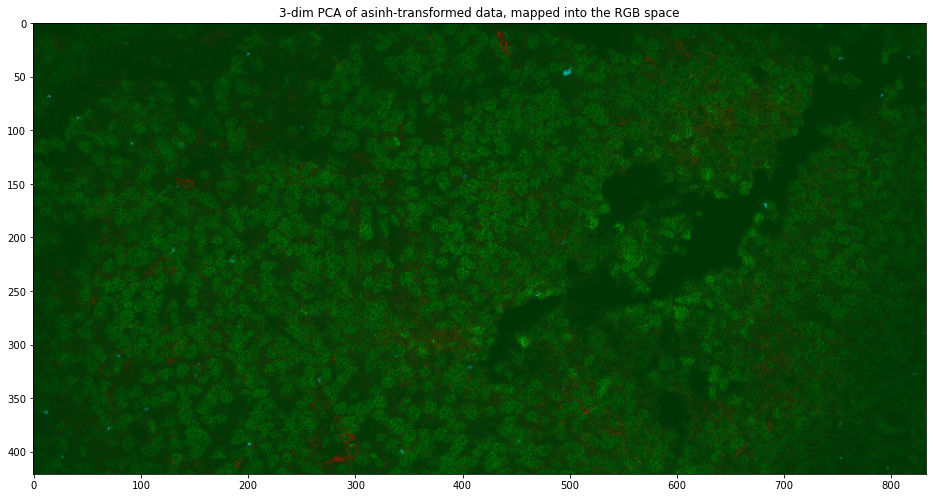

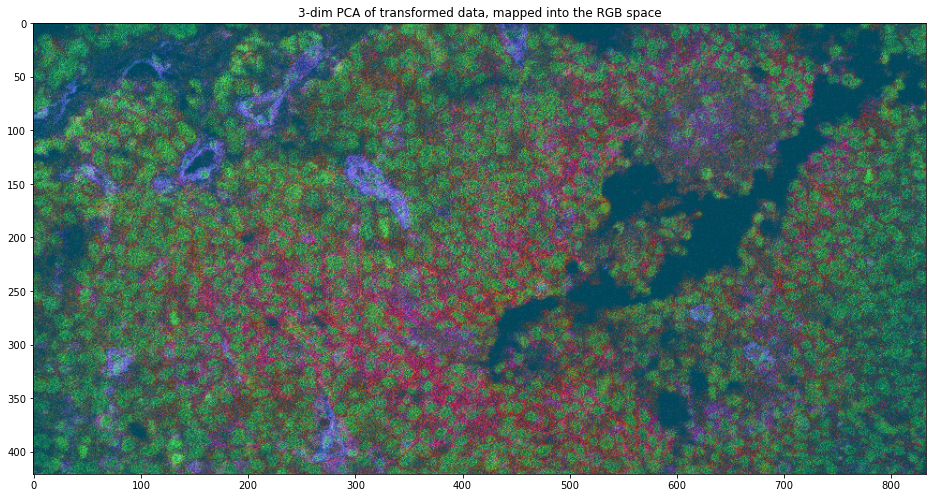

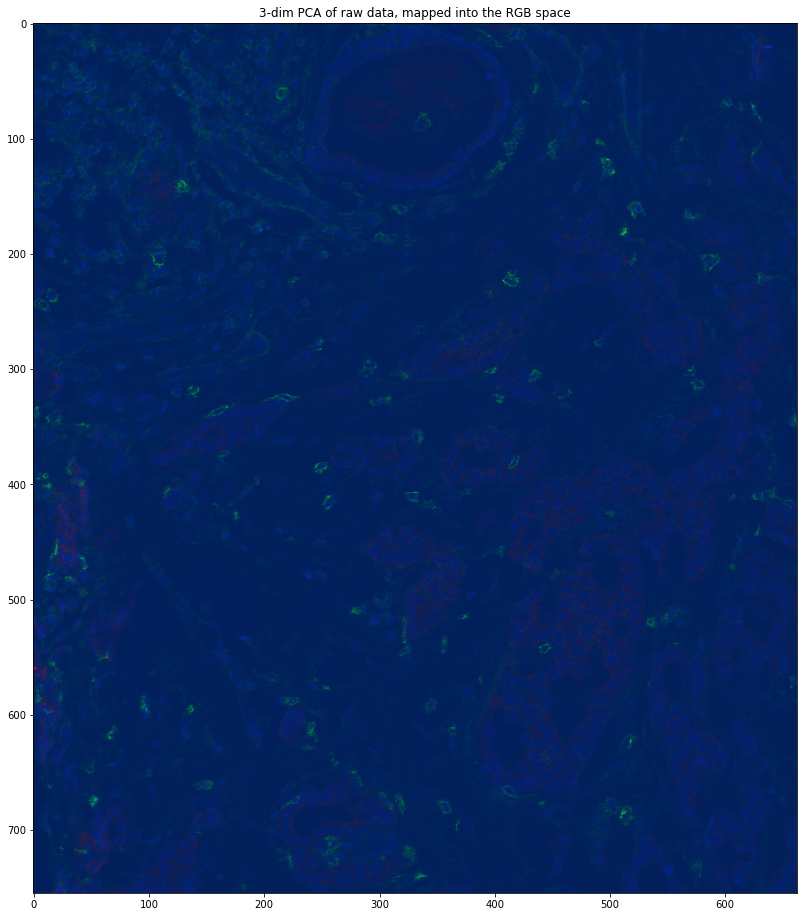

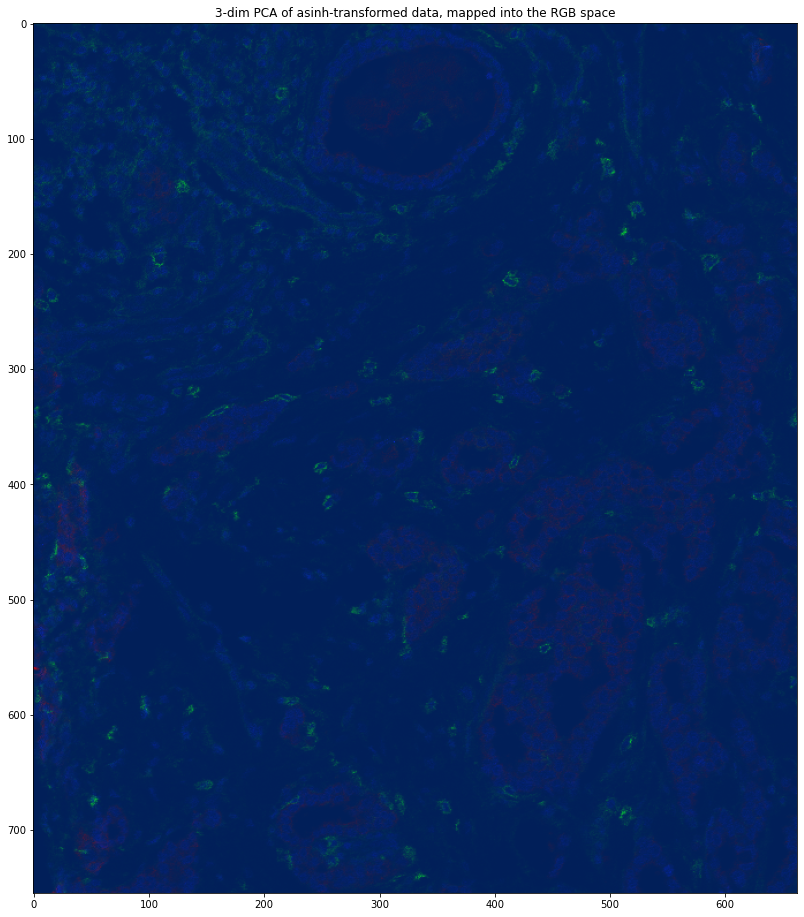

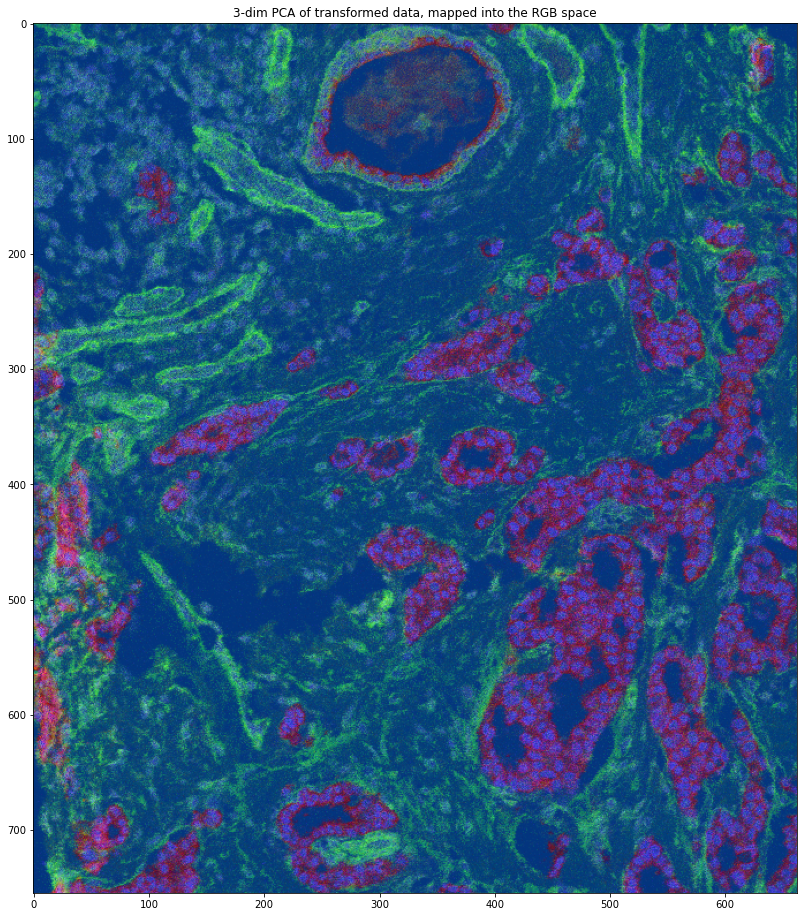

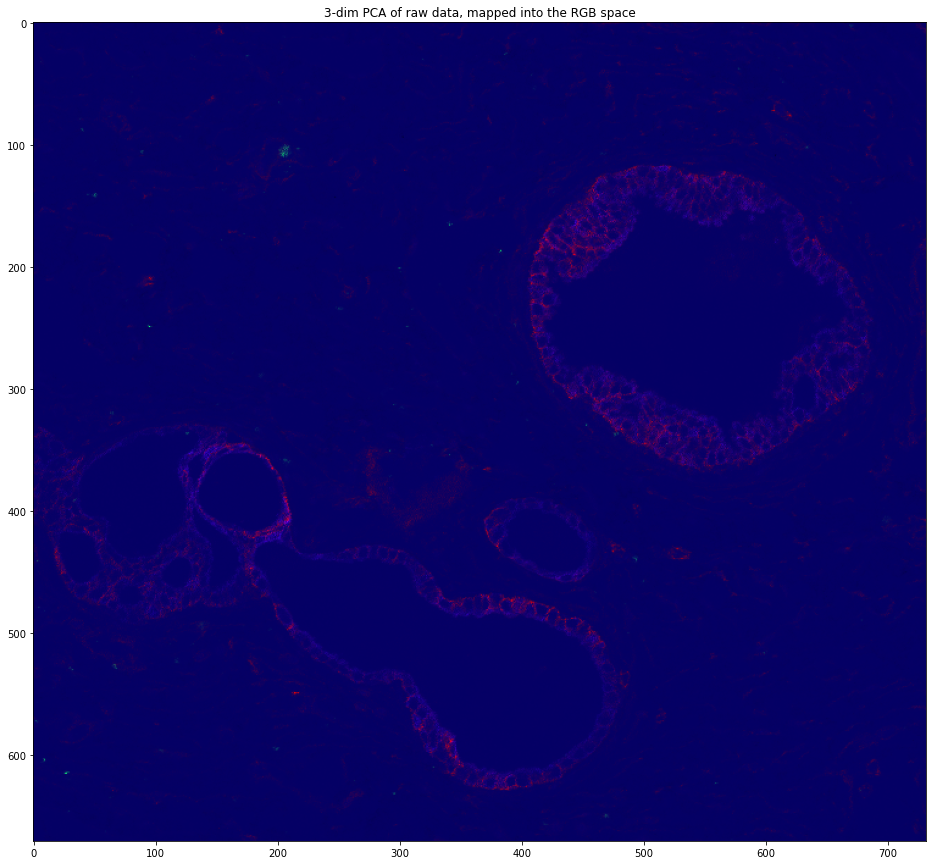

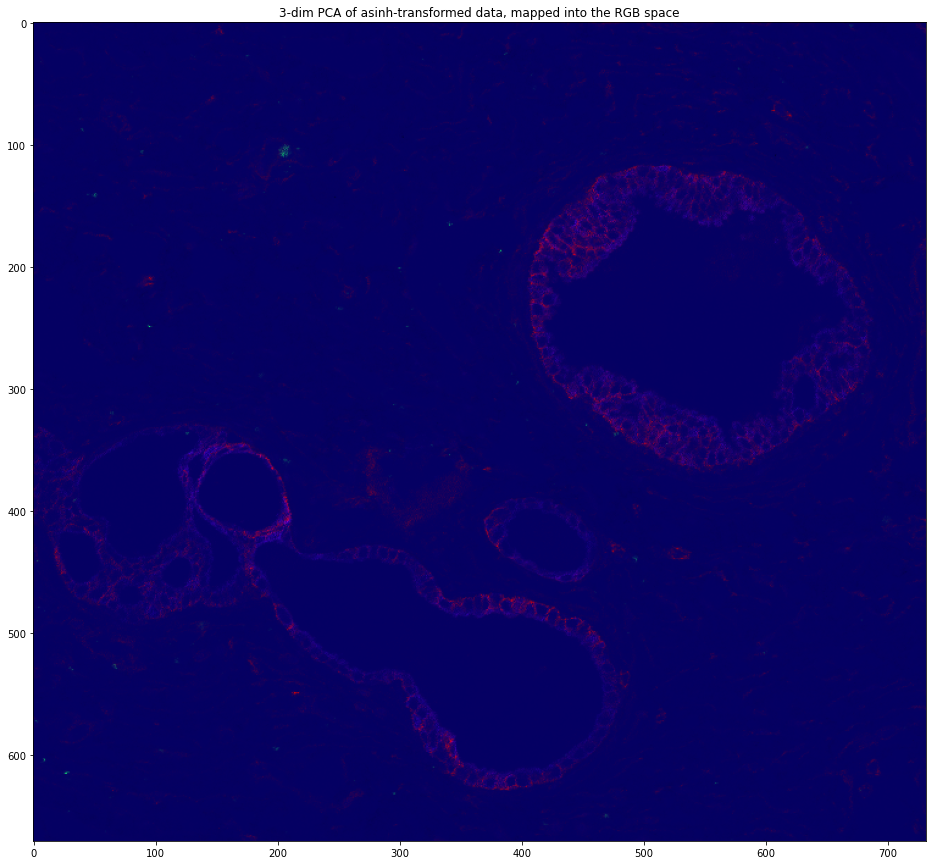

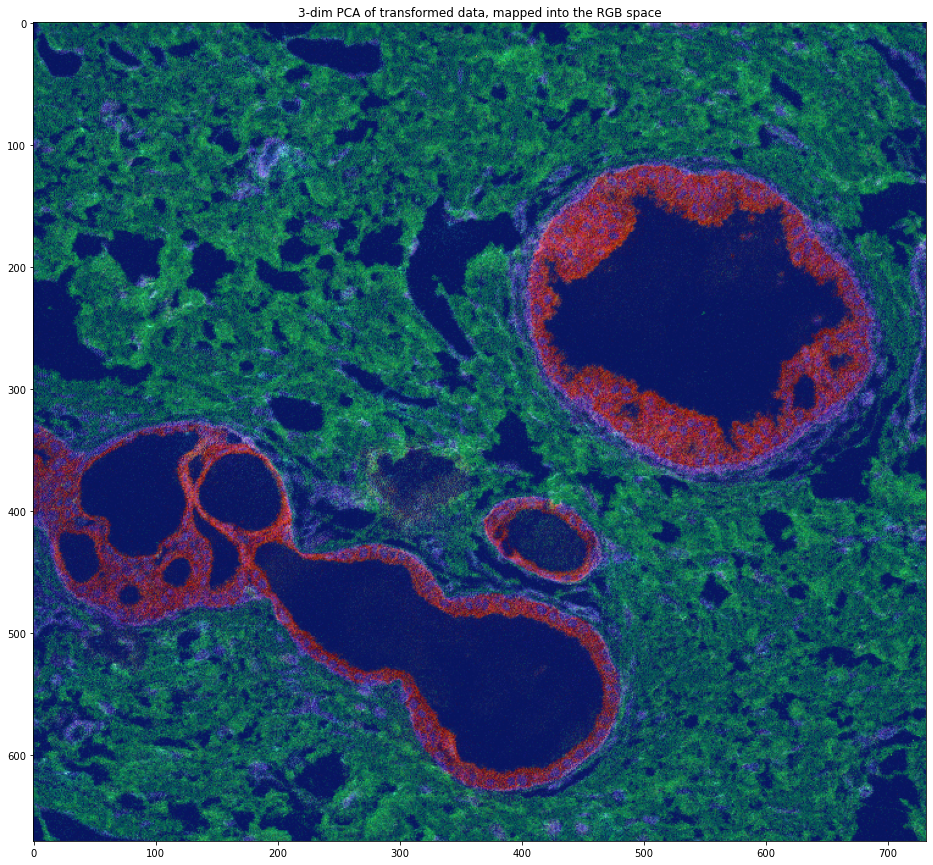

In [16]:
from sklearn.decomposition import PCA

for i in [0, 7, 19]:
    o = ds.filenames[i]
    x = ds[i].numpy()
    reducer = PCA(n_components=3)
    a, b = x.shape[:2]
    x = x.reshape(-1, 39)
    pca = reducer.fit_transform(x)
    
    mins = np.min(pca, axis=0)
    maxs = np.max(pca, axis=0)
    pca = (pca - mins) / (maxs - mins)
    pca.shape = (a, b, 3)
    pca.shape

    plt.figure(figsize=(16, 16))
    plt.imshow(pca)
    plt.title('3-dim PCA of raw data, mapped into the RGB space')
    plt.show()

    plt.figure(figsize=(16, 16))
    y = np.arcsinh(pca)
    plt.title('3-dim PCA of asinh-transformed data, mapped into the RGB space')
    plt.imshow(y)
    
    z = scale(o, x)
    z_pca = reducer.fit_transform(z)
    z_mins = np.min(z_pca, axis=0)
    z_maxs = np.max(z_pca, axis=0)
    z_pca = (z_pca - z_mins) / (z_maxs - z_mins)
    z_pca.shape = (a, b, 3)
    
    plt.figure(figsize=(16, 16))
    plt.imshow(z_pca)
    plt.title('3-dim PCA of transformed data, mapped into the RGB space')
    plt.show()

In [17]:
import torch

def get_filtered_labels_mapping(ome_index, ome_filename, split):
    import pickle
    f = os.path.join('data/spatial_uzh_processed/a', f'ok_cells_{split}.npy')
    d = pickle.load(open(f, 'rb'))
    list_of_cells = d['list_of_cells']
    list_of_ome_filenames = d['list_of_ome_filenames']
    list_of_ome_indices = d['list_of_ome_indices']
    list_of_cell_ids = d['list_of_cell_ids']
    cell_is_ok = d['cell_is_ok']
    begin = list_of_ome_filenames.index(ome_filename)
    end = len(list_of_ome_filenames) - list_of_ome_filenames[::-1].index(ome_filename)
    # print(list_of_ome_filenames[begin])
    # print(list_of_ome_filenames[end - 1])
    # print(list_of_ome_filenames[end])
    # print(list_of_ome_filenames[end + 1])
    oks = cell_is_ok[begin: end]
    # labels = list_of_cell_ids[begin: end]
    # print(oks.shape)
    # print(t.shape)
    l0 = np.array(list(range(np.sum(oks).item())))
    l1 = list_of_cell_ids[ome_index][oks]
    assert len(l0) == len(l1)
    d = dict(zip(l0, l1))
    return d

def colorize_masks(ome_index, ome_filename, channel_expression, masks, split, cmap_name='viridis'):
    # from data import get_filtered_labels_mapping
    d = get_filtered_labels_mapping(ome_index, ome_filename, split)
    new_masks = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks[masks == l, :] = (1., 0., 0., 1.)
    new_masks[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        a = torch.min(channel_expression)
        b = torch.max(channel_expression)
        e = channel_expression[k].item()
        normalized_expression = (e - a) / (b - a)
        import matplotlib

        cmap = matplotlib.cm.get_cmap(cmap_name)
        ee = cmap(normalized_expression.item())
        new_masks[masks == v.item(), :] = ee
    return new_masks

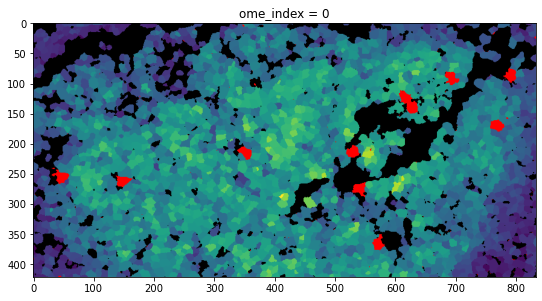

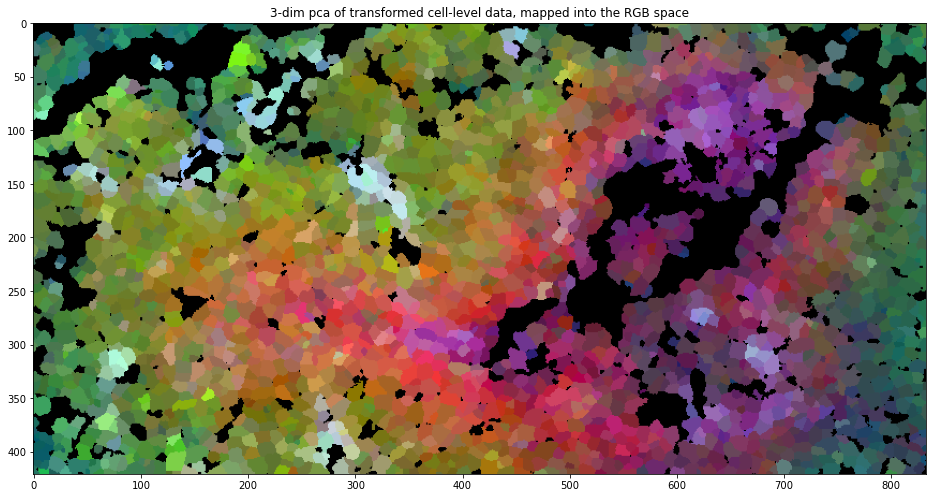

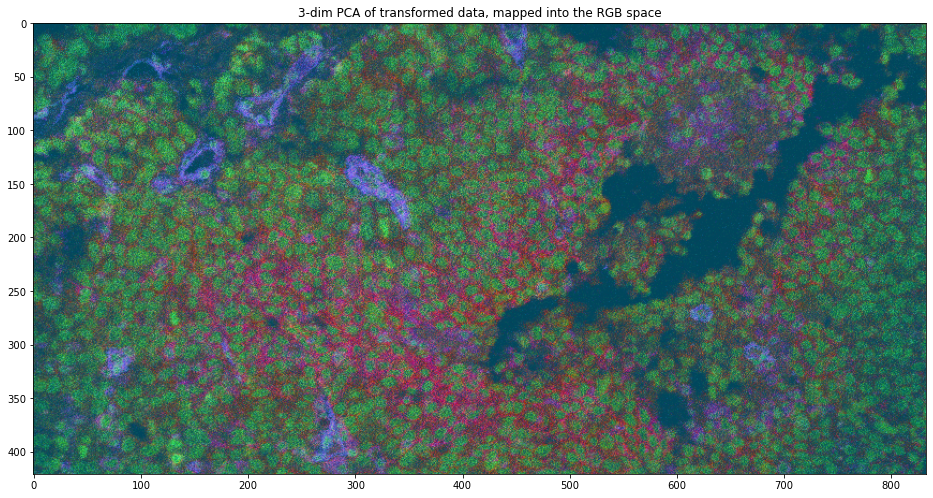

In [18]:
from data import TransformedMeanDataset, MasksDataset, OmeDataset

ds = OmeDataset('train')
ds_train = TransformedMeanDataset('train')
masks_ds_train = MasksDataset('train')

for ome_index in [0]: #[0, 7, 19]:
    ome_filename = ds_train.filenames[ome_index]
    channel = 0
    expression = ds_train[ome_index]
    
    from sklearn.decomposition import PCA
    reducer = PCA(3)
    pca = reducer.fit_transform(expression.numpy())
    mins = np.min(pca, axis=0)
    maxs = np.max(pca, axis=0)
    pca = (pca - mins) / (maxs - mins)
    ones = np.ones(len(pca)).reshape((-1, 1))
    pca = np.concatenate([pca, ones], axis=1)
    
    masks = masks_ds_train[ome_index]
    
    d = get_filtered_labels_mapping(ome_index, ome_filename, 'train')
    
    new_masks = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks[masks == l, :] = (0., 0., 0., 1.)
    new_masks[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks[masks == v.item(), :] = pca[k, :]
    
    channel_expression = expression[:, 0]
    colorized_masks = colorize_masks(ome_index, ome_filename, channel_expression, masks, split='train', cmap_name='viridis')
    plt.figure(figsize=(9, 9))    
    plt.imshow(colorized_masks)
    plt.title(f'ome_index = {ome_index}')
    plt.show()
    
    plt.figure(figsize=(16, 16))    
    plt.imshow(new_masks)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'3-dim pca of transformed cell-level data, mapped into the RGB space')
    plt.show()
    
    o = ds.filenames[ome_index]
    x = ds[ome_index].numpy()
    
    z = scale(o, x)
    a, b = z.shape[:2]
    z = z.reshape(-1, 39)
    z_pca = reducer.fit_transform(z)
    z_mins = np.min(z_pca, axis=0)
    z_maxs = np.max(z_pca, axis=0)
    z_pca = (z_pca - z_mins) / (z_maxs - z_mins)
    z_pca.shape = (a, b, 3)
    
    plt.figure(figsize=(16, 16))
    plt.imshow(z_pca)
    plt.title('3-dim PCA of transformed data, mapped into the RGB space')
    plt.show()

# Comparing to the VAE

In [19]:
import h5py
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
from pprint import pprint
import numpy as np
import torch
import os

In [20]:
a = '/data/l989o/deployed/a/data/spatial_uzh_processed/a/'
instances = [
#     '/data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LR_VB_S_0.0001__1e-06__False',
    '/data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LR_VB_S_0.0014685885989200848__3.8608662714605464e-08__False',
#     '/data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LD_2',
    '/data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LD_3'
]
assert np.prod([os.path.isdir(a) for a in instances])

In [21]:
from data import RawMeanDataset

raw_train = RawMeanDataset('train')
counts = [(len(a), i) for i, a in enumerate(raw_train)]
counts = sorted(counts, key=lambda x: x[0])
train_sort = np.array([c[1] for c in counts])

raw_val = RawMeanDataset('validation')
counts = [(len(a), i) for i, a in enumerate(raw_val)]
counts = sorted(counts, key=lambda x: x[0])
val_sort = np.array([c[1] for c in counts])

In [22]:
from data import file_path

def the_path(instance, f):
    root = file_path(instance)
    assert os.path.isdir(root), root
    return os.path.join(root, f)

In [23]:
class SpearmanStuff:
    pass

In [24]:
ds_train = TransformedMeanDataset('train')
ds_validation = TransformedMeanDataset('validation')

from models.train_vae import Vae
import ignite.distributed as idist
from h5_logger import H5Logger
import torch
from tqdm import tqdm

for i, instance in enumerate(instances):
    if i == 0:
        n = 5
    elif i == 1:
        n = 3
    else:
        raise ValueError()
    model = Vae(in_channels=39, hidden_layer_dimensions=n, out_channels=39)
    model = model.to(idist.device())
    model.load_state_dict(torch.load(the_path(instance, 'model.torch')))
    for split in ['train', 'validation']:
        path = the_path(instance, f'embedding_{split}.hdf5')
        if os.path.isfile(path):
            os.remove(path)
        if not os.path.isfile(path):
            EPOCH = 50
            print(f'embedding not found, creating it for EPOCH = {EPOCH}, path =', path)
            embedding_training_logger = H5Logger(path)
            embedding_training_logger.clear()
            if split == 'train':
                ds = ds_train
            elif split == 'validation':
                ds = ds_validation
            else:
                raise ValueError()

            # only_first_5_samples = False
            with torch.no_grad():
                list_of_reconstructed = []
                list_of_mu = []
                list_of_log_var = []
                iterator = tqdm(ds, desc='embedding', position=0, leave=True)
                for i, data in enumerate(iterator):
                    data.to(idist.device())
                    data = torch.unsqueeze(data, 0)
                    # data = [torch.unsqueeze(x, 0) for x in data]
                    recon_batch, mu, log_var = model.forward_step(data, model)
                    ome_filename = ds.filenames[i]

                    def u(x):
                        if len(x.shape) == 3 and x.shape[0] == 1:
                            x = x.reshape(-1, x.shape[2])
                        return x

                    f = lambda x: x.cpu().detach().numpy()
                    # reconstructed = ome_dataset.scale_back(reconstructed.cpu().detach(), i)
                    a = f(u(recon_batch))
                    b = f(u(mu))
                    c = f(u(log_var))
                    data = {f'{ome_filename}/reconstructed': a,
                            f'{ome_filename}/mu': b,
                            f'{ome_filename}/log_var': c}
                    embedding_training_logger.log(EPOCH, data)

embedding:   0%|          | 1/226 [00:00<00:43,  5.12it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LR_VB_S_0.0014685885989200848__3.8608662714605464e-08__False/embedding_train.hdf5


embedding:  13%|█▎        | 15/113 [00:00<00:00, 146.53it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LR_VB_S_0.0014685885989200848__3.8608662714605464e-08__False/embedding_validation.hdf5


embedding:   4%|▍         | 9/226 [00:00<00:02, 85.72it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LD_3/embedding_train.hdf5


embedding:  13%|█▎        | 15/113 [00:00<00:00, 146.36it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LD_3/embedding_validation.hdf5


embedding: 100%|██████████| 113/113 [00:00<00:00, 149.16it/s]


In [25]:
# s does not stand for anything
class SInstance:
    pass

sinstances = [SpearmanStuff() for _ in instances]

In [26]:
import numpy as np
from tqdm import tqdm

all_k = set()
for instance, sinstance in zip(instances, sinstances):
    f = the_path(instance, 'embedding_train.hdf5')
    with h5py.File(f, 'r') as f5:
        assert len(f5.keys()) == 1
        k, v = f5.items().__iter__().__next__()
        if len(all_k) == 0:
            bbb = True
        print(len(v.keys()))
        all_k.add(k)
        assert len(all_k) <= 1
        if bbb:
            print(f'EPOCH {k}', flush=True)
            
        o_train = ds_train.filenames
        print(len(o_train))
        original_list = []
        mu_list = []
        log_var_list = []
        for i, o in enumerate(tqdm(o_train, desc='spearamn train')):
            original = ds_train[i].clone().detach().numpy()
            mu = v[o]['mu'][...]
            log_var = v[o]['log_var'][...]
            assert mu.shape == log_var.shape
            assert len(original) == len(mu)
            original_list.append(original)
            mu_list.append(mu)
            log_var_list.append(log_var)
        sinstance.mu_list = mu_list
        sinstance.log_var_list = log_var_list
        
        sinstance.all_original = np.concatenate(original_list, axis=0)
        sinstance.all_mu = np.concatenate(mu_list, axis=0)
        sinstance.all_log_var = np.concatenate(log_var_list, axis=0)

226
EPOCH epoch50


spearamn train:   5%|▍         | 11/226 [00:00<00:02, 106.55it/s]

226


spearamn train: 100%|██████████| 226/226 [00:02<00:00, 108.06it/s]

226
EPOCH epoch50



spearamn train:   5%|▍         | 11/226 [00:00<00:02, 105.79it/s]

226


spearamn train: 100%|██████████| 226/226 [00:02<00:00, 108.77it/s]


In [27]:
mu0 = sinstances[0].all_mu
mu1 = sinstances[1].all_mu

print(mu0.shape, mu1.shape)

(449434, 5) (449434, 3)


In [28]:
f = os.path.join('data/spatial_uzh_processed/a', f'ok_cells_train.npy')
d = pickle.load(open(f, 'rb'))
list_of_cells = d['list_of_cells']
cell_is_ok = d['cell_is_ok']

n = 0
for a in list_of_cells:
    n += len(a)
print(n)

m = 0
for a in cell_is_ok:
    m += np.sum(a)
print(m)

516890
449434


In [29]:
import torch

def get_filtered_labels_mapping(ome_index, ome_filename, split):
    import pickle
    f = os.path.join('data/spatial_uzh_processed/a', f'ok_cells_{split}.npy')
    d = pickle.load(open(f, 'rb'))
    list_of_cells = d['list_of_cells']
    list_of_ome_filenames = d['list_of_ome_filenames']
    list_of_ome_indices = d['list_of_ome_indices']
    list_of_cell_ids = d['list_of_cell_ids']
    cell_is_ok = d['cell_is_ok']
    begin = list_of_ome_filenames.index(ome_filename)
    end = len(list_of_ome_filenames) - list_of_ome_filenames[::-1].index(ome_filename)
    # print(list_of_ome_filenames[begin])
    # print(list_of_ome_filenames[end - 1])
    # print(list_of_ome_filenames[end])
    # print(list_of_ome_filenames[end + 1])
    oks = cell_is_ok[begin: end]
    # labels = list_of_cell_ids[begin: end]
    # print(oks.shape)
    # print(t.shape)
    l0 = np.array(list(range(np.sum(oks).item())))
    l1 = list_of_cell_ids[ome_index][oks]
    assert len(l0) == len(l1)
    d = dict(zip(l0, l1))
    return d

def colorize_masks(ome_index, ome_filename, channel_expression, masks, split, cmap_name='viridis'):
    # from data import get_filtered_labels_mapping
    d = get_filtered_labels_mapping(ome_index, ome_filename, split)
    new_masks = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks[masks == l, :] = (1., 0., 0., 1.)
    new_masks[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        a = torch.min(channel_expression)
        b = torch.max(channel_expression)
        e = channel_expression[k].item()
        normalized_expression = (e - a) / (b - a)
        import matplotlib

        cmap = matplotlib.cm.get_cmap(cmap_name)
        ee = cmap(normalized_expression.item())
        new_masks[masks == v.item(), :] = ee
    return new_masks

In [30]:
def pca_and_scale(x):
    reducer = PCA(3)
    pca = reducer.fit_transform(x)
    mins = np.min(pca, axis=0)
    maxs = np.max(pca, axis=0)
    z = (pca - mins) / (maxs - mins)
    return z

(2691, 4)


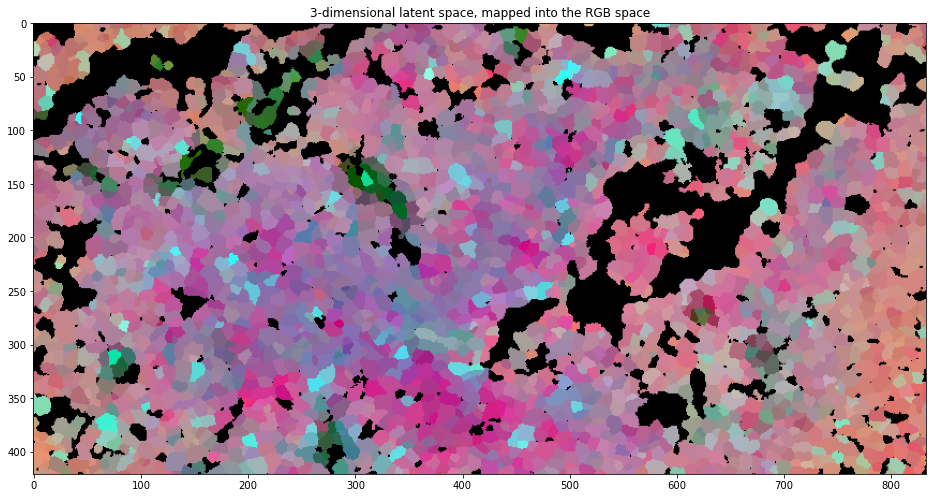

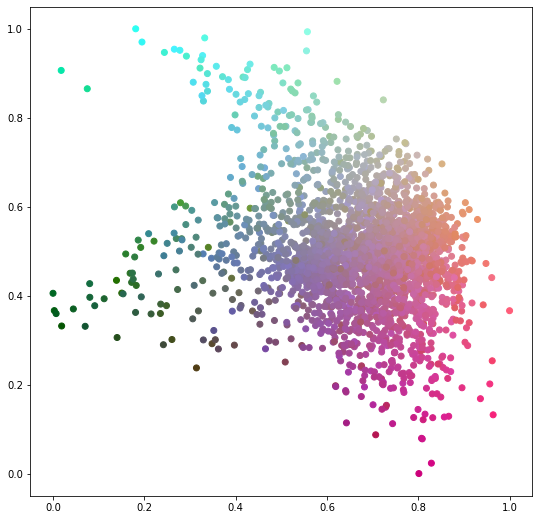

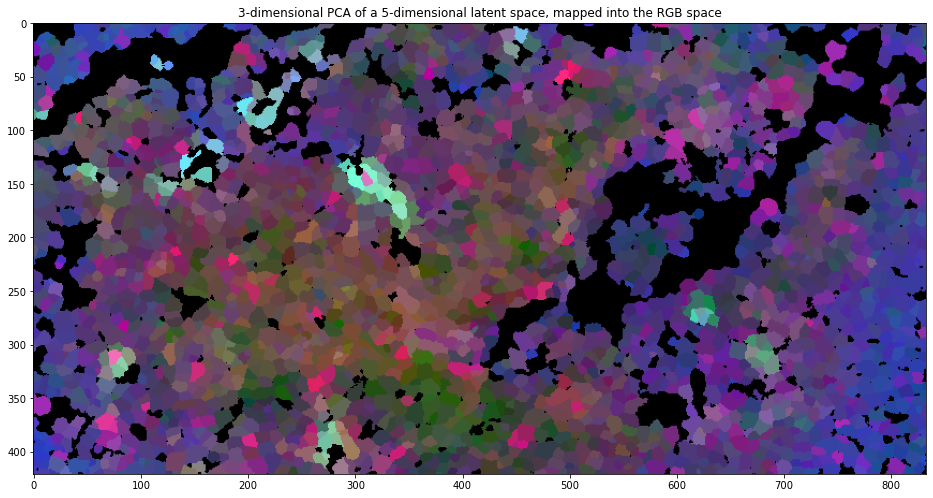

(2691, 4)


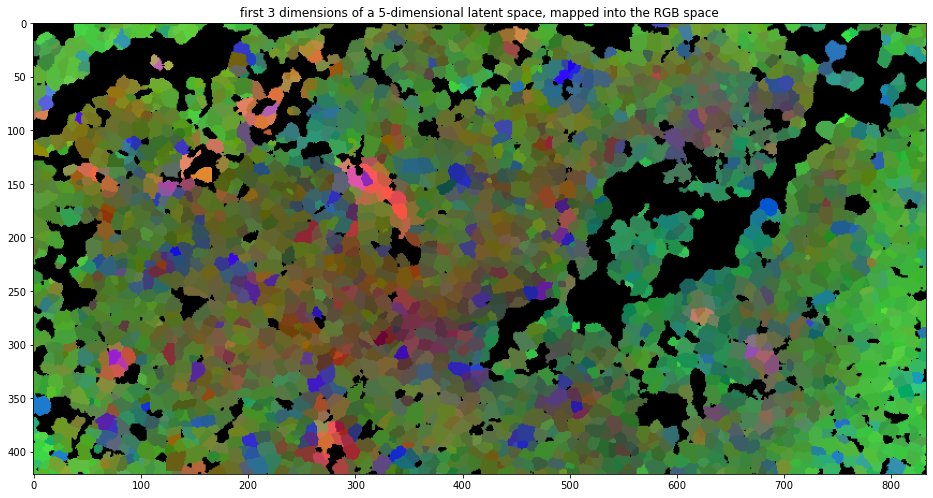

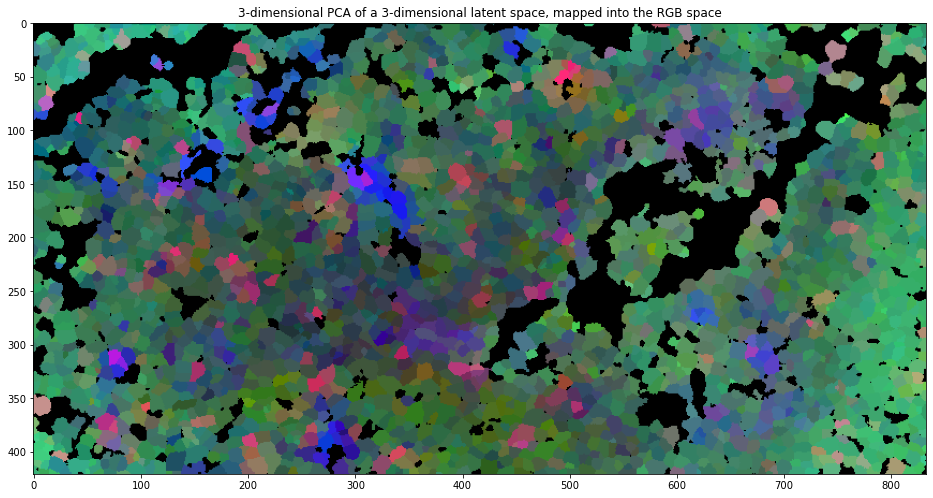

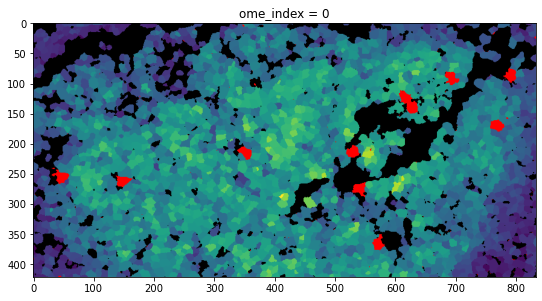

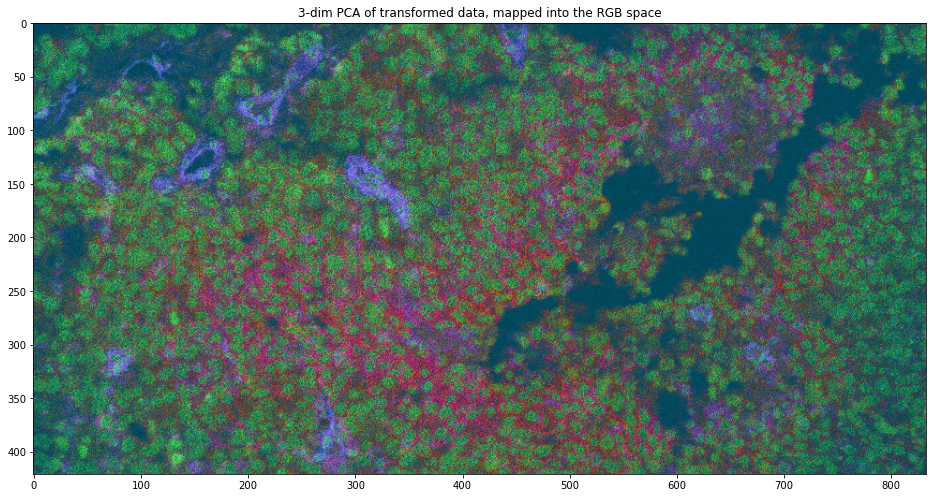

(2630, 4)


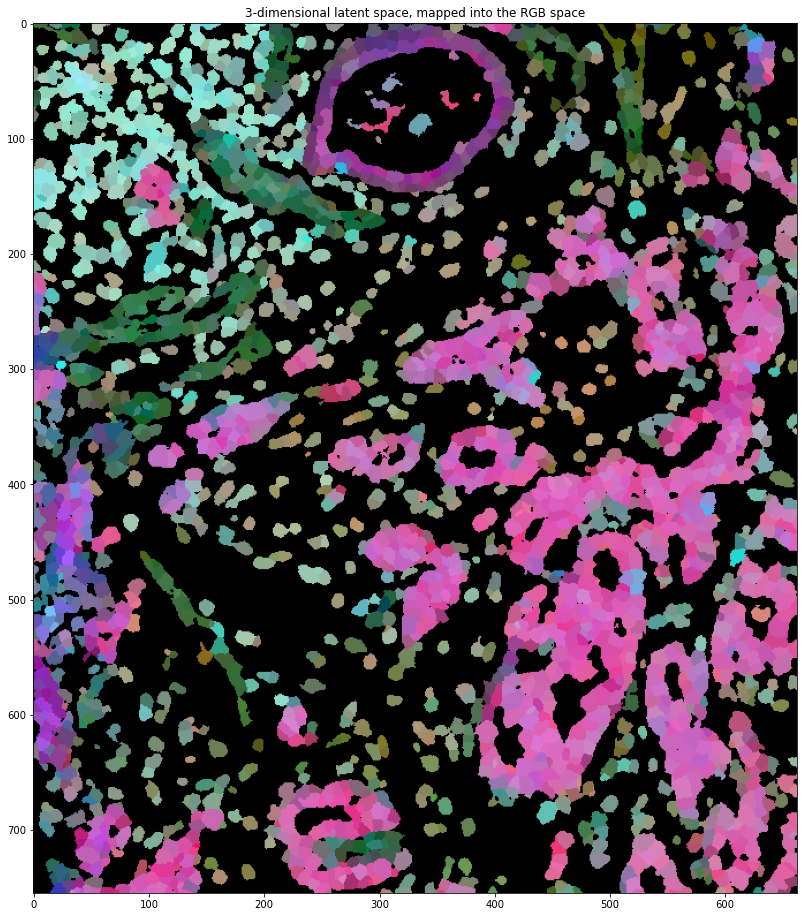

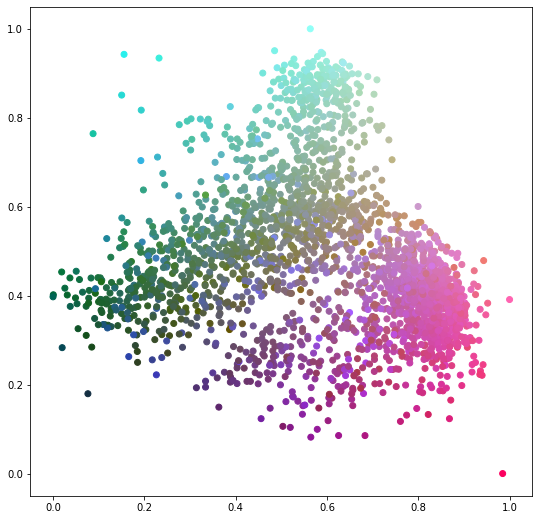

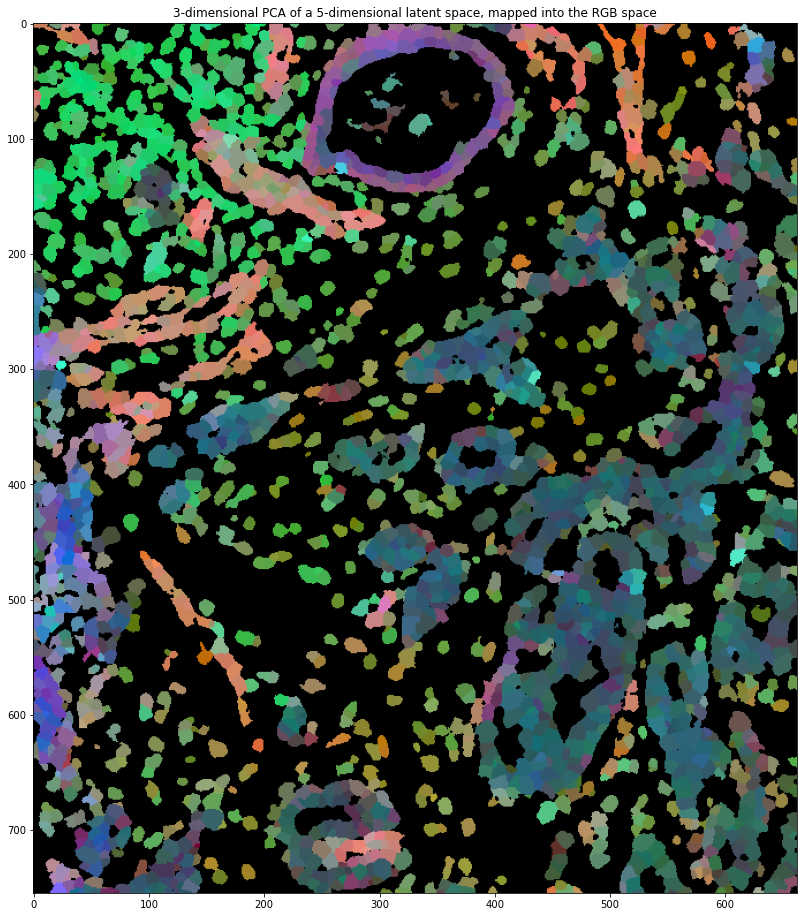

(2630, 4)


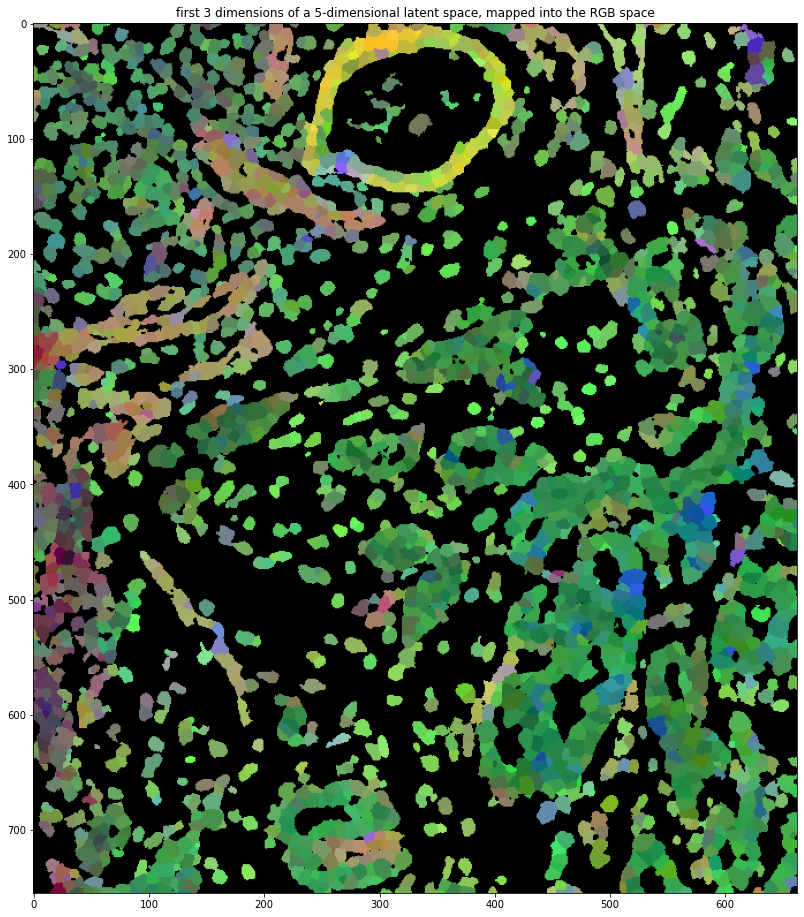

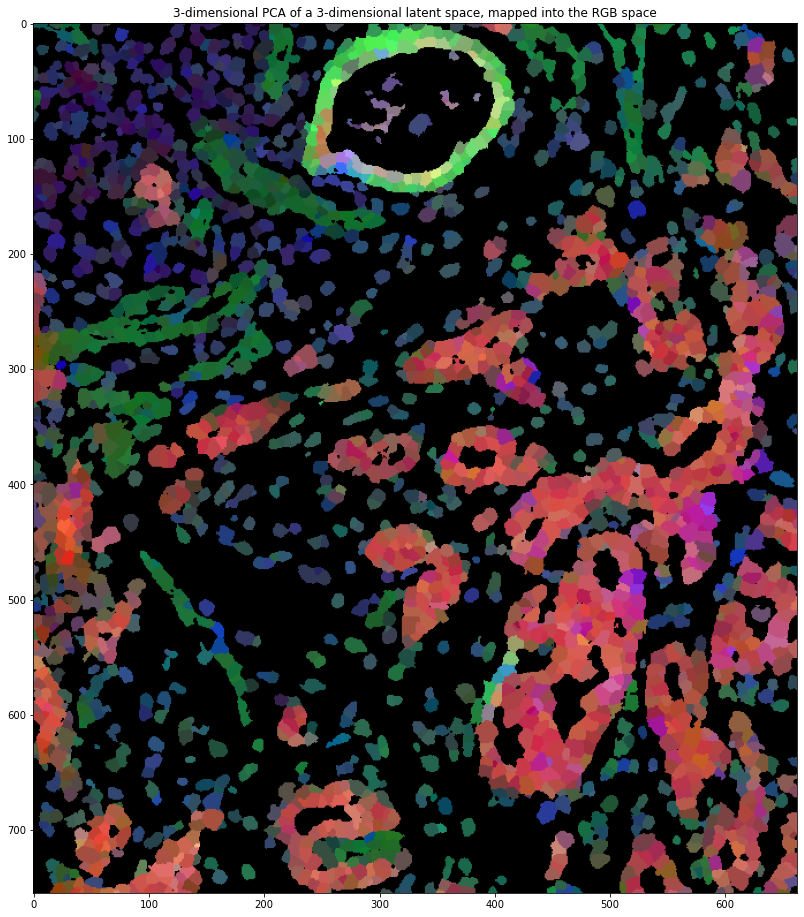

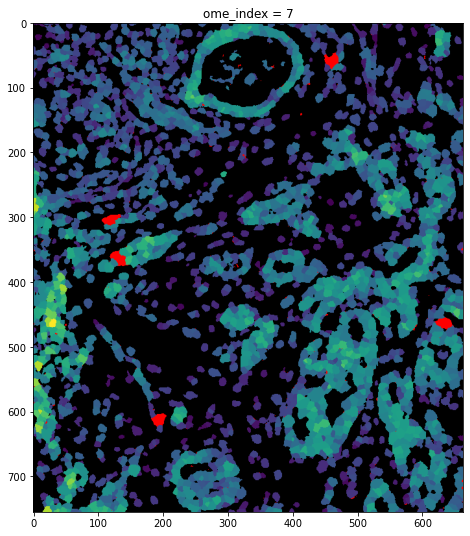

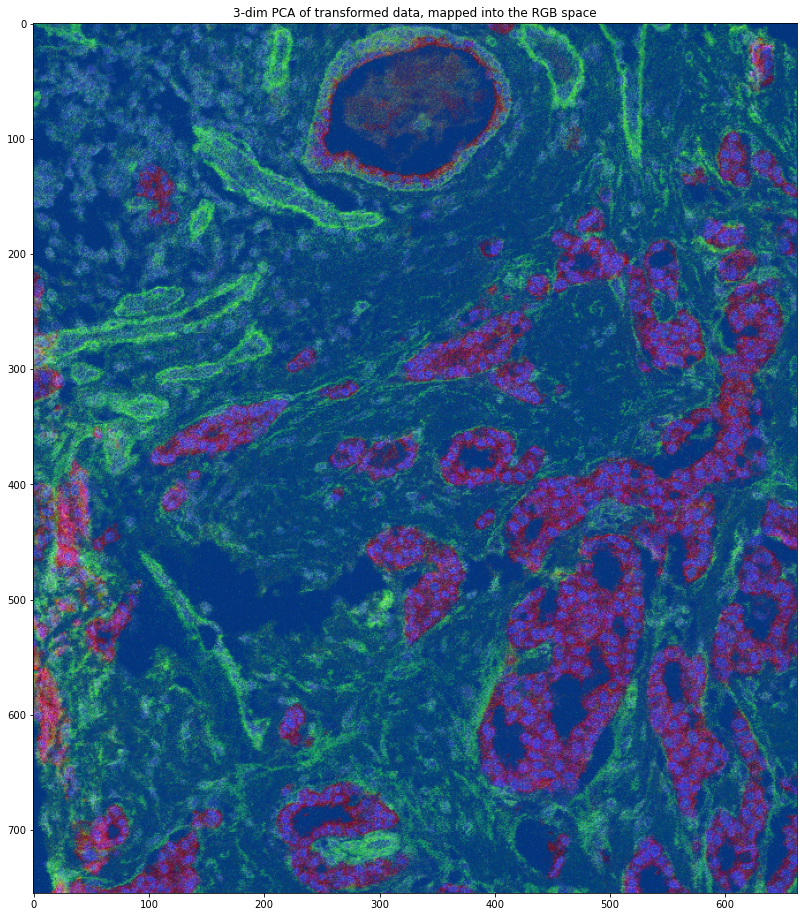

(1144, 4)


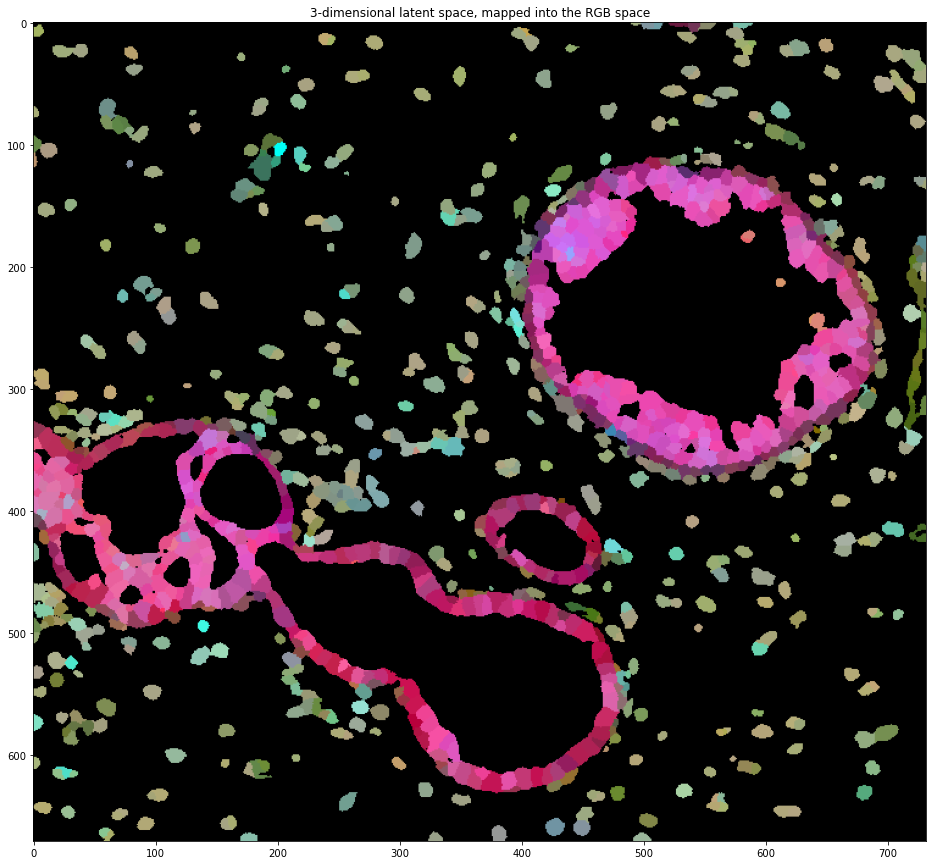

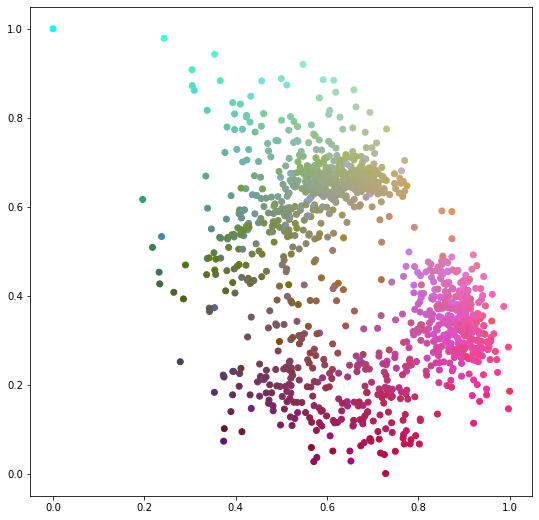

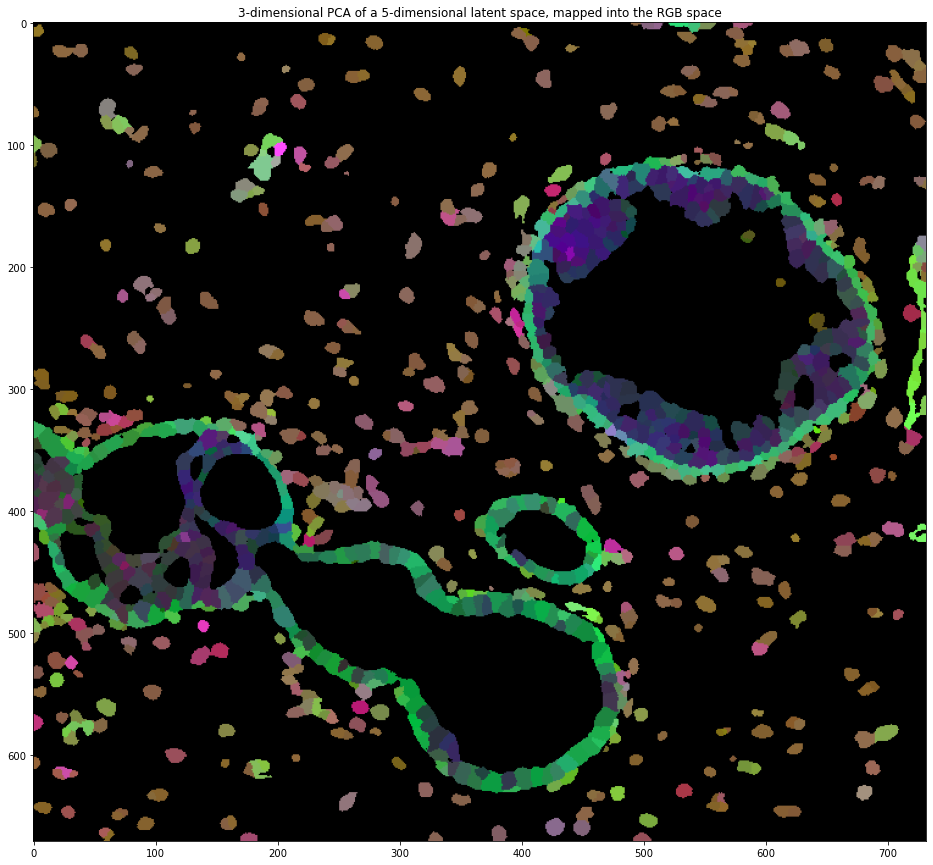

(1144, 4)


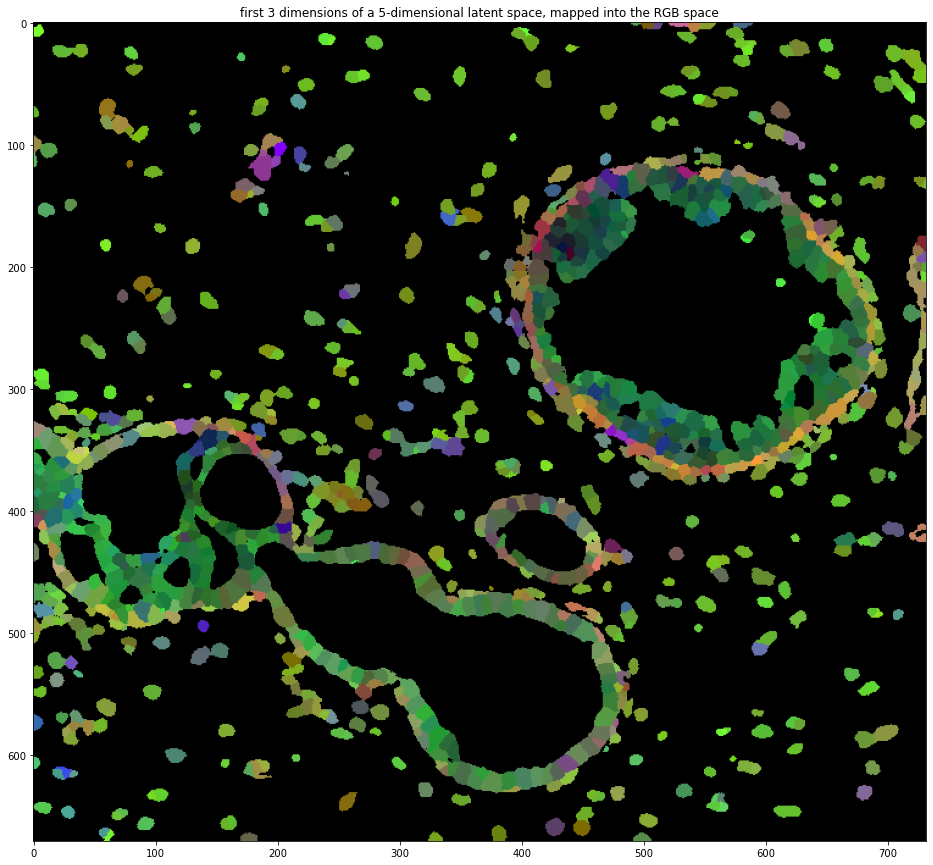

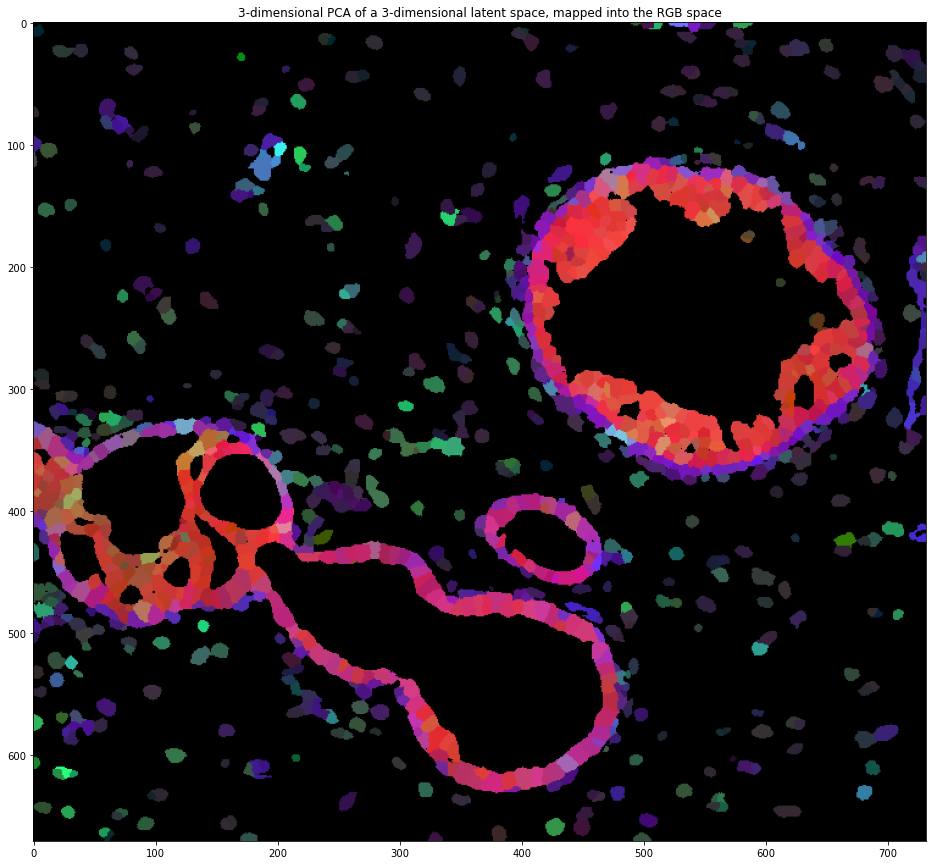

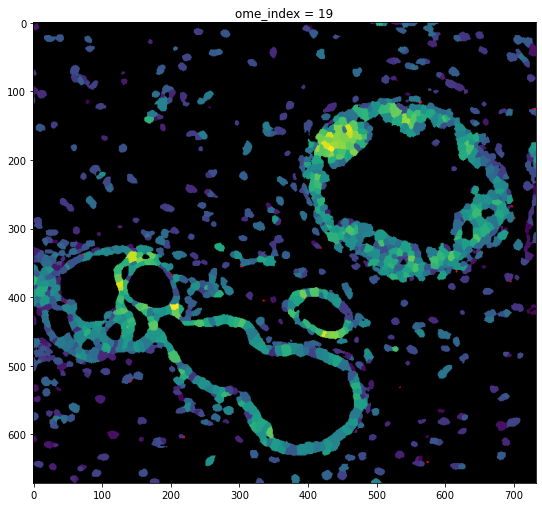

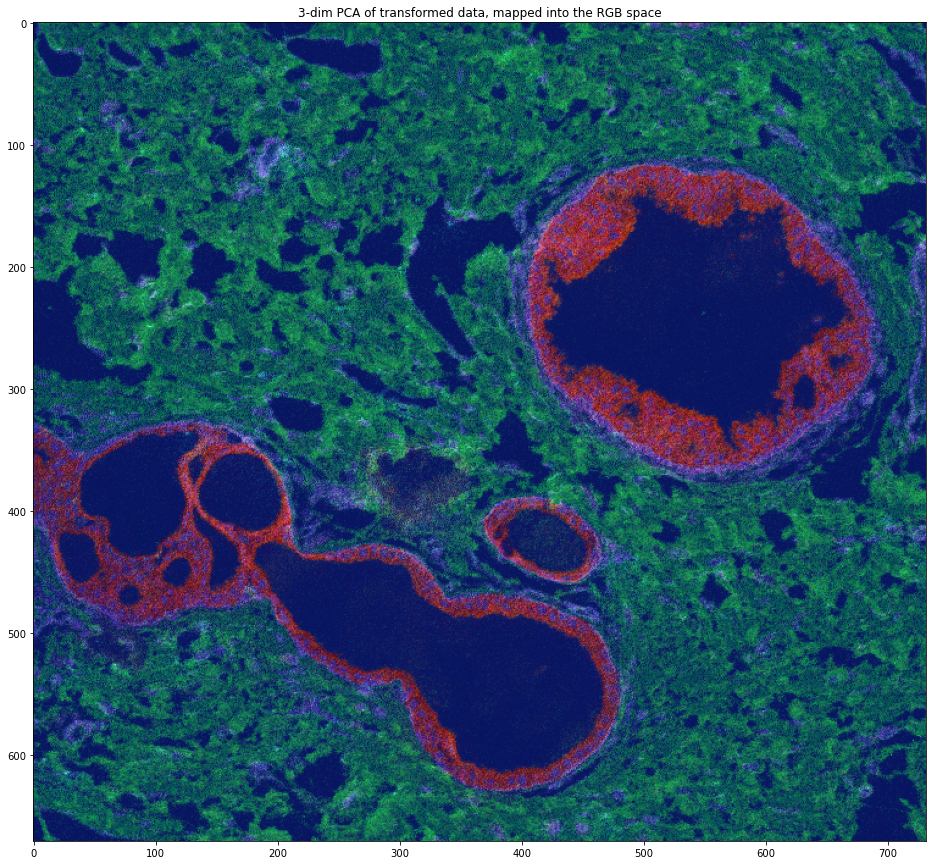

In [31]:
from data import TransformedMeanDataset, MasksDataset

ds = OmeDataset('train')
ds_train = TransformedMeanDataset('train')
masks_ds_train = MasksDataset('train')

index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))

for ome_index in [0, 7, 19]:
    ome_filename = ds_train.filenames[ome_index]
    channel = 0
    expression = ds_train[ome_index]
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    
    # --------------- embedded cells 1 ---------------
    embedded_cells1 = mu1[begin:end]
    assert len(embedded_cells1) == len(expression)

    pca_of_embedded_cells1 = pca_and_scale(embedded_cells1)
    mins = np.min(embedded_cells1, axis=0)
    maxs = np.max(embedded_cells1, axis=0)
    embedded_cells1 = (embedded_cells1 - mins) / (maxs - mins)
    ones = np.ones(len(embedded_cells1)).reshape((-1, 1))
    embedded_cells1 = np.concatenate([embedded_cells1, ones], axis=1)
    pca_of_embedded_cells1 = np.concatenate([pca_of_embedded_cells1, ones], axis=1)
    print(pca_of_embedded_cells1.shape)
    
    masks = masks_ds_train[ome_index]
    d = get_filtered_labels_mapping(ome_index, ome_filename, 'train')
    
    new_masks1 = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks1[masks == l, :] = (0., 0., 0., 1.)
    new_masks1[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks1[masks == v.item(), :] = embedded_cells1[k, :]  #pca[k, :]

    plt.figure(figsize=(16, 16))    
    plt.imshow(new_masks1)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'3-dimensional latent space, mapped into the RGB space')
    plt.show()
    
    list_of_colors = [embedded_cells1[i, :] for i in range(len(embedded_cells1))]
    plt.figure(figsize=(9, 9))
    plt.scatter(embedded_cells1[:, 0], embedded_cells1[:, 1], c=list_of_colors)
    plt.show()
    
    
    new_masks1 = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks1[masks == l, :] = (0., 0., 0., 1.)
    new_masks1[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks1[masks == v.item(), :] = pca_of_embedded_cells1[k, :]  #pca[k, :]

    plt.figure(figsize=(16, 16))    
    plt.imshow(new_masks1)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'3-dimensional PCA of a 5-dimensional latent space, mapped into the RGB space')
    plt.show()
    # --------------- embedded cells 0 ---------------
    embedded_cells0 = mu0[begin:end]
    pca_of_embedded_cells0 = pca_and_scale(embedded_cells0)
    assert len(embedded_cells0) == len(expression)
    
    mins = np.min(embedded_cells0, axis=0)
    maxs = np.max(embedded_cells0, axis=0)
    embedded_cells0 = (embedded_cells0 - mins) / (maxs - mins)
    ones = np.ones(len(embedded_cells0)).reshape((-1, 1))
    embedded_cells0 = np.concatenate([embedded_cells0[:, :3], ones], axis=1)
    pca_of_embedded_cells0 = np.concatenate([pca_of_embedded_cells0, ones], axis=1)
    print(pca_of_embedded_cells0.shape)
    
    new_masks0 = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks0[masks == l, :] = (0., 0., 0., 1.)
    new_masks0[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks0[masks == v.item(), :] = embedded_cells0[k, :]  #pca[k, :]
    
    plt.figure(figsize=(16, 16))    
    plt.imshow(new_masks0)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'first 3 dimensions of a 5-dimensional latent space, mapped into the RGB space')
    plt.show()
    
    
    new_masks0 = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks0[masks == l, :] = (0., 0., 0., 1.)
    new_masks0[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks0[masks == v.item(), :] = pca_of_embedded_cells0[k, :]  #pca[k, :]

    plt.figure(figsize=(16, 16))
    plt.imshow(new_masks0)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'3-dimensional PCA of a 3-dimensional latent space, mapped into the RGB space')
    plt.show()
    # --------------- plotting ---------------
    channel_expression = expression[:, 0]
    colorized_masks = colorize_masks(ome_index, ome_filename, channel_expression, masks, split='train', cmap_name='viridis')
    plt.figure(figsize=(9, 9))
    plt.imshow(colorized_masks)
    plt.title(f'ome_index = {ome_index}')
    plt.show() 
    
    o = ds.filenames[ome_index]
    x = ds[ome_index].numpy()
    
    z = scale(o, x)
    a, b = z.shape[:2]
    z = z.reshape(-1, 39)
    z_pca = reducer.fit_transform(z)
    z_mins = np.min(z_pca, axis=0)
    z_maxs = np.max(z_pca, axis=0)
    z_pca = (z_pca - z_mins) / (z_maxs - z_mins)
    z_pca.shape = (a, b, 3)
    
    plt.figure(figsize=(16, 16))
    plt.imshow(z_pca)
    plt.title('3-dim PCA of transformed data, mapped into the RGB space')
    plt.show()

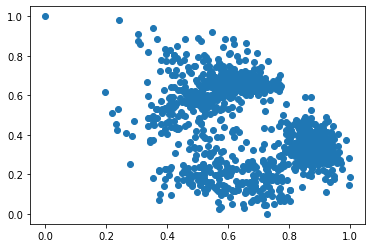

In [32]:
plt.scatter(embedded_cells1[:, 0], embedded_cells1[:, 1])

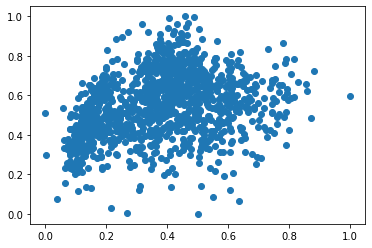

In [33]:
plt.scatter(embedded_cells0[:, 0], embedded_cells0[:, 1])

In [34]:
import scanpy as sc
import anndata as ad

import numpy as np
np.random.seed(0)
random_choice = np.random.choice(len(sinstances[0].all_original), 10000, replace=False)

plt.style.use('default')

----------------------------------------------------------------------------------------------------
/data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset_LD_3


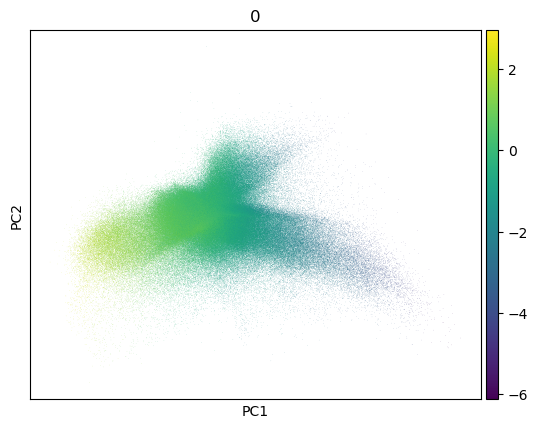

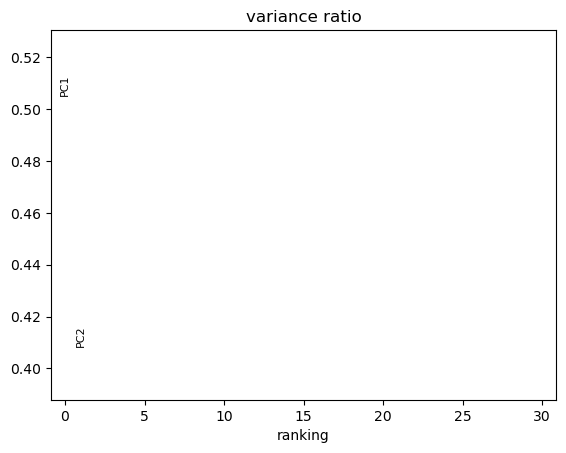

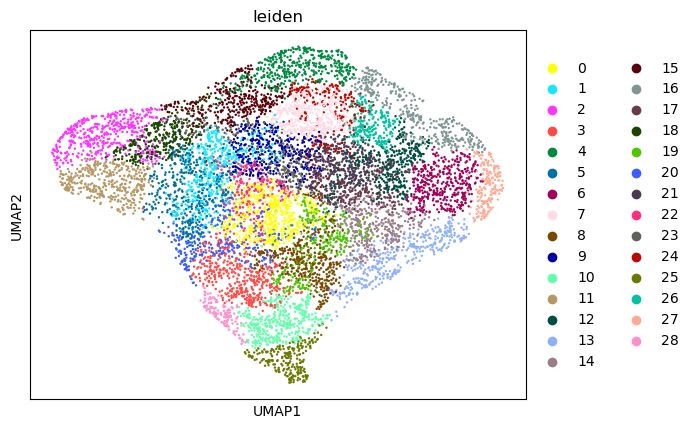

In [35]:
%matplotlib inline
plt.style.use('default')

instance = instances[1]
sinstance = sinstances[1]

print('-' * 100)
print(instance)
a0 = ad.AnnData(sinstance.all_original)
a1 = ad.AnnData(sinstance.all_mu)
a2 = ad.AnnData(sinstance.all_log_var)

sc.tl.pca(a1, svd_solver='arpack')
sc.pl.pca(a1, color='0')
sc.pl.pca_variance_ratio(a1)
# sc.pl.pca_variance_ratio(a0, log=True)
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

In [36]:
%matplotlib widget

from mpl_toolkits.mplot3d import Axes3D

u = b1.obsm['X_umap']

x = b1.X.copy()
mins = np.min(x, axis=0)
maxs = np.max(x, axis=0)
x = (x - mins) / (maxs - mins)

list_of_colors = [x[i, :] for i in range(len(x))]

fig = plt.figure(figsize=(9, 9))
ax = Axes3D(fig)

ax.set_xlabel('latent 1')
ax.set_ylabel('latent 2')
ax.set_zlabel('latent 3')
ax.scatter(b1.X[:, 0], b1.X[:, 1], b1.X[:, 2], c=list_of_colors, s=6)

import os
os.makedirs(file_path('frames_3d'), exist_ok=True)
for ii in tqdm(range(0, 360, 2), desc='generating frames'):
    ax.view_init(elev=30., azim=ii)
    plt.savefig(file_path(f'frames_3d/movie{ii:03d}.png'))
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

generating frames: 100%|██████████| 180/180 [00:30<00:00,  5.84it/s]


In [37]:
%matplotlib inline

In [38]:
ls /data/l989o/spatial_uzh/data/spatial_uzh_processed/a/frames_3d/

movie000.png  movie072.png  movie144.png  movie216.png  movie288.png
movie002.png  movie074.png  movie146.png  movie218.png  movie290.png
movie004.png  movie076.png  movie148.png  movie220.png  movie292.png
movie006.png  movie078.png  movie150.png  movie222.png  movie294.png
movie008.png  movie080.png  movie152.png  movie224.png  movie296.png
movie010.png  movie082.png  movie154.png  movie226.png  movie298.png
movie012.png  movie084.png  movie156.png  movie228.png  movie300.png
movie014.png  movie086.png  movie158.png  movie230.png  movie302.png
movie016.png  movie088.png  movie160.png  movie232.png  movie304.png
movie018.png  movie090.png  movie162.png  movie234.png  movie306.png
movie020.png  movie092.png  movie164.png  movie236.png  movie308.png
movie022.png  movie094.png  movie166.png  movie238.png  movie310.png
movie024.png  movie096.png  movie168.png  movie240.png  movie312.png
movie026.png  movie098.png  movie170.png  movie242.png  movie314.png
movie028.png  movie100.png  movie1

In [39]:
import glob
from PIL import Image

# filepaths
fp_in = '/data/l989o/spatial_uzh/data/spatial_uzh_processed/a/frames_3d/movie*.png'
fp_out = '/data/l989o/a/frames_3d.gif'

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=60, loop=0)

# Global PCA

In [40]:
from data import TransformedMeanDataset, MasksDataset

ds = OmeDataset('train')
ds_train = TransformedMeanDataset('train')
masks_ds_train = MasksDataset('train')

l = []
for x in ds_train:
    l.append(x)
z = np.concatenate(l, axis=0)

from sklearn.decomposition import PCA
reducer = PCA(3)
pca = reducer.fit_transform(z)
original_big_pca = pca.copy()
mins = np.min(pca, axis=0)
maxs = np.max(pca, axis=0)
pca = (pca - mins) / (maxs - mins)
ones = np.ones(len(pca)).reshape((-1, 1))
pca = np.concatenate([pca, ones], axis=1)

pca.shape

(449434, 4)

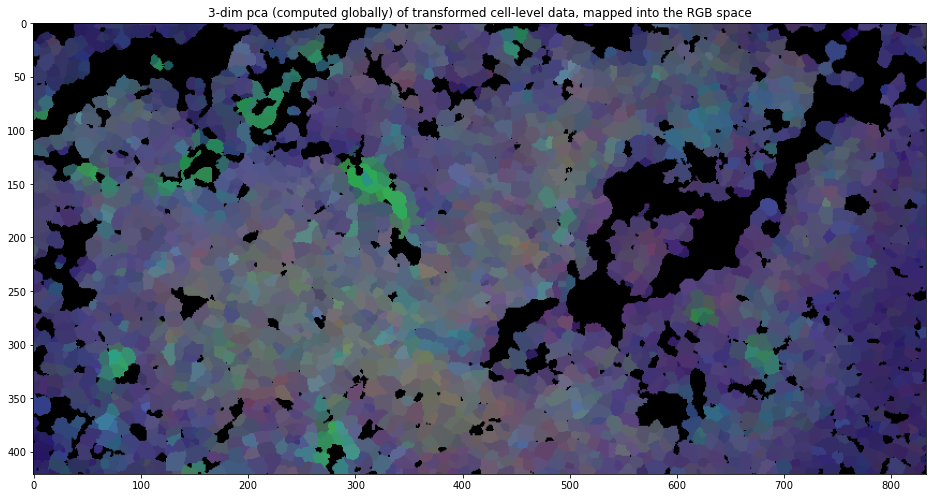

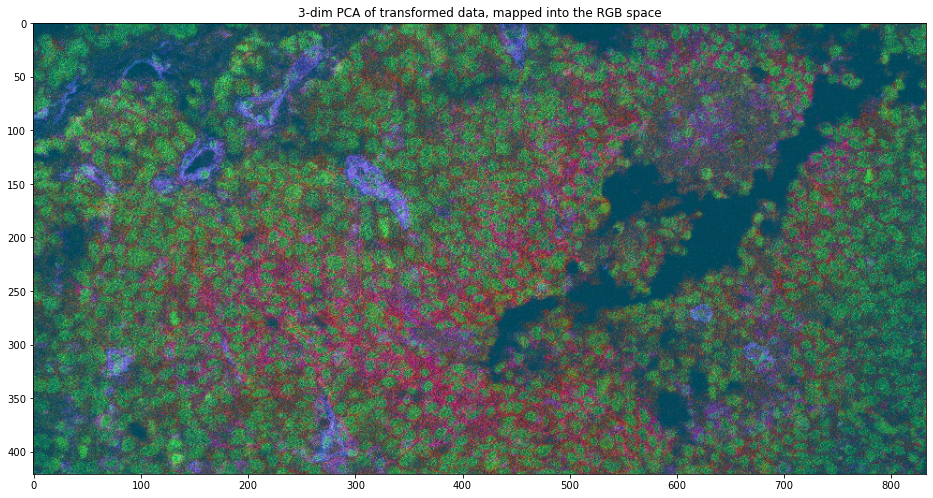

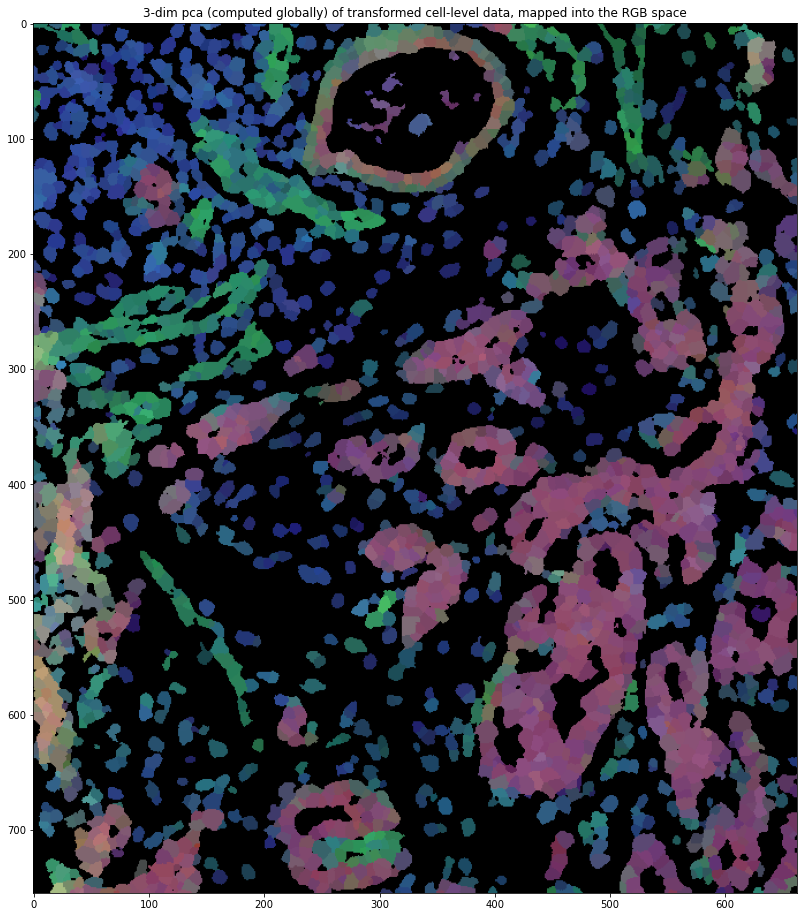

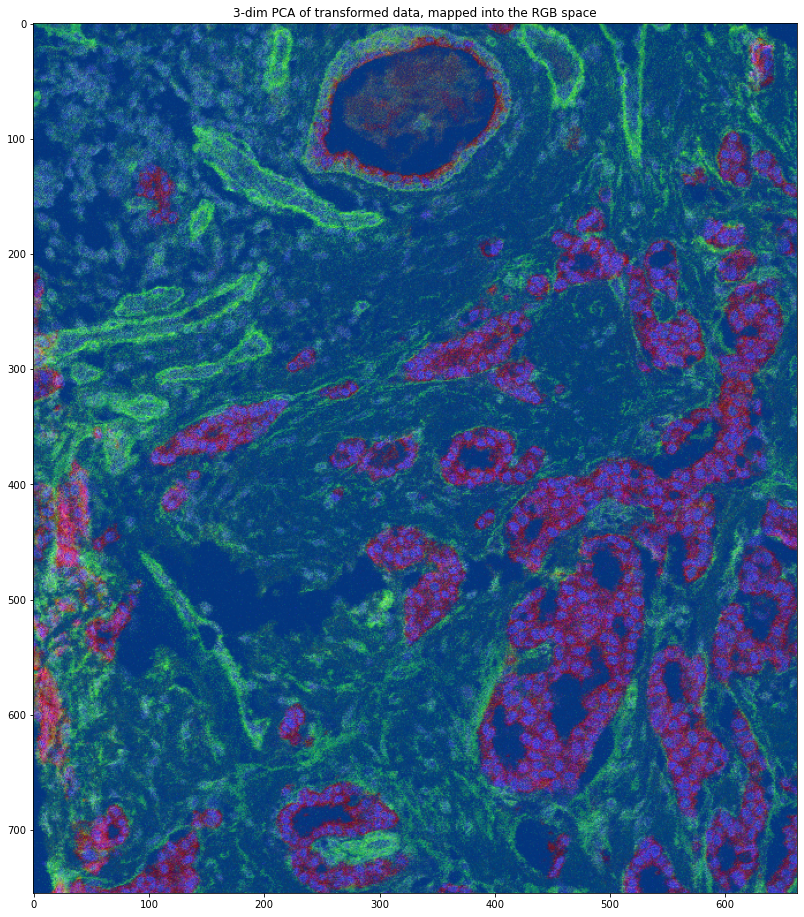

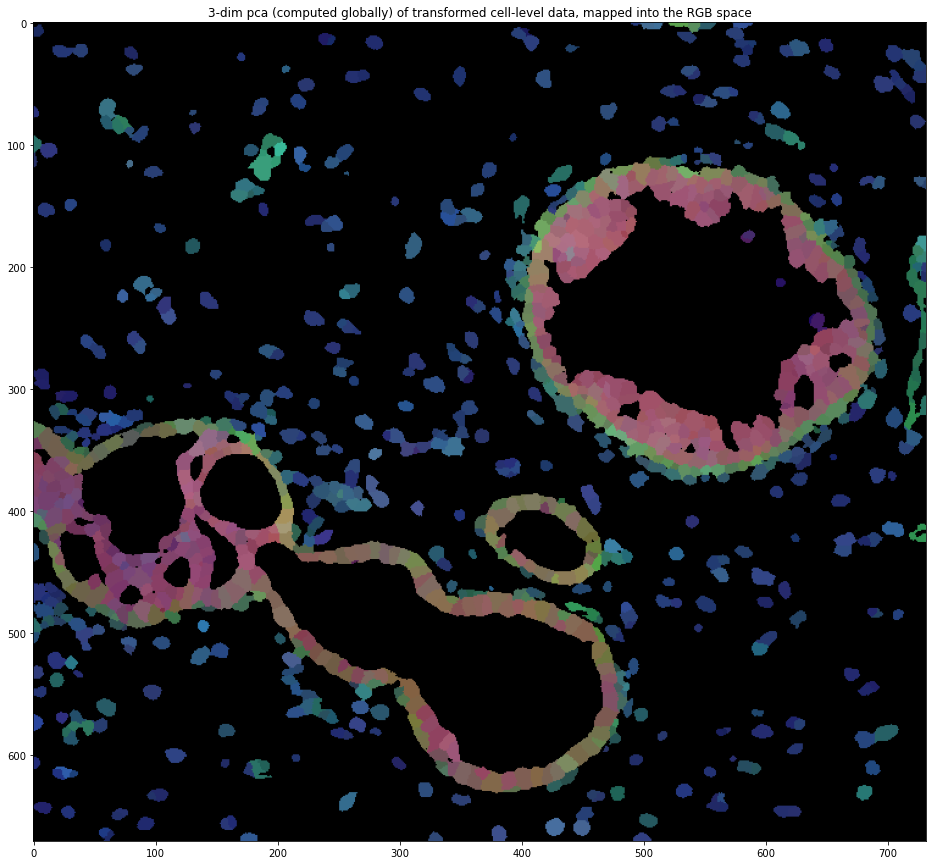

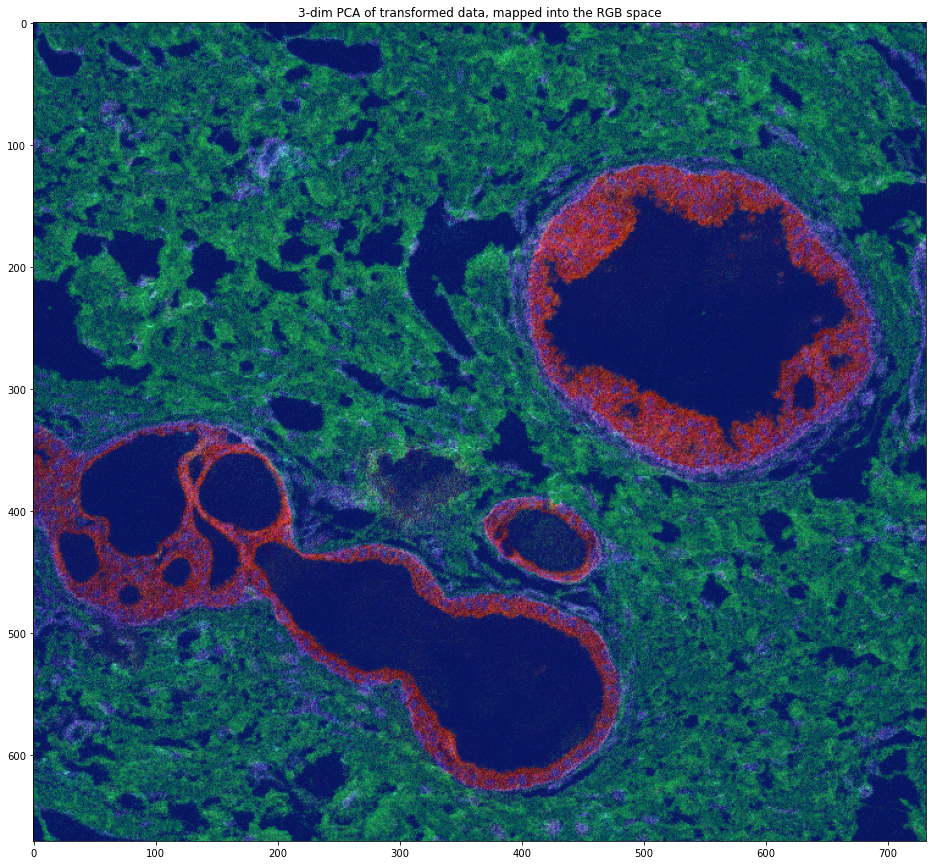

In [41]:
index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))

for ome_index in [0, 7, 19]:
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    
    ome_filename = ds_train.filenames[ome_index]
    channel = 0
    expression = ds_train[ome_index]
    masks = masks_ds_train[ome_index]
    
    d = get_filtered_labels_mapping(ome_index, ome_filename, 'train')
    
    new_masks = np.zeros((masks.shape[0], masks.shape[1], 4))
    omitted_labels = set(list(range(np.max(masks)))).difference([dd.item() for dd in d.values()]).difference({0})
    for l in omitted_labels:
        new_masks[masks == l, :] = (0., 0., 0., 1.)
    new_masks[masks == 0, :] = (0., 0., 0., 1.)
    for k, v in d.items():
        new_masks[masks == v.item(), :] = pca[begin: end][k, :]
    
    plt.figure(figsize=(16, 16))
    plt.imshow(new_masks)
    plt.title(f'ome_index = {ome_index}')
    plt.title(f'3-dim pca (computed globally) of transformed cell-level data, mapped into the RGB space')
    plt.show()
    
    o = ds.filenames[ome_index]
    x = ds[ome_index].numpy()
    
    z = scale(o, x)
    a, b = z.shape[:2]
    z = z.reshape(-1, 39)
    z_pca = reducer.fit_transform(z)
    z_mins = np.min(z_pca, axis=0)
    z_maxs = np.max(z_pca, axis=0)
    z_pca = (z_pca - z_mins) / (z_maxs - z_mins)
    z_pca.shape = (a, b, 3)
    
    plt.figure(figsize=(16, 16))
    plt.imshow(z_pca)
    plt.title('3-dim PCA of transformed data, mapped into the RGB space')
    plt.show()

In [42]:
%matplotlib widget

from mpl_toolkits.mplot3d import Axes3D

pca_copy = pca[random_choice, :].copy()
x = original_big_pca[random_choice, :].copy()
list_of_colors = [pca_copy[i, :] for i in range(len(pca_copy))]

fig = plt.figure(figsize=(9, 9))
ax = Axes3D(fig)

ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')
ax.set_zlabel('PC 3')
ax.scatter(x[:, 0], x[:, 1], x[:, 2], c=list_of_colors, s=6)

import os
os.makedirs(file_path('frames_3d_pca'), exist_ok=True)
for ii in tqdm(range(0, 360, 2), desc='generating frames'):
    ax.view_init(elev=30., azim=ii)
    plt.savefig(file_path(f'frames_3d_pca/movie{ii:03d}.png'))
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

generating frames: 100%|██████████| 180/180 [00:31<00:00,  5.74it/s]


In [43]:
%matplotlib inline

In [44]:
import glob
from PIL import Image

# filepaths
fp_in = '/data/l989o/spatial_uzh/data/spatial_uzh_processed/a/frames_3d_pca/movie*.png'
fp_out = '/data/l989o/a/frames_3d_pca.gif'

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=60, loop=0)

# Images on umaps

## raw data

In [45]:
import math
from tqdm import tqdm
from data import RawMeanDataset

ds = RawMeanDataset('train')
list_of_z = []
i = 0
list_of_patient_index = []
for i, x in enumerate(tqdm(ds)):
#    q1 = np.quantile(x0.numpy(), q=0.5, axis=0)
#    if all(q1 < 1e-5):
#        print(i - 1)
#    cofactor = q1 / math.sinh(1)
    ii = torch.tensor([i] * len(x))
#    z = np.arcsinh(x0)
    list_of_z.append(x)
    list_of_patient_index.append(ii)
t_train_raw2 = torch.cat(list_of_z, dim=0)
patient_indexes = torch.cat(list_of_patient_index)

100%|██████████| 226/226 [00:01<00:00, 130.17it/s]


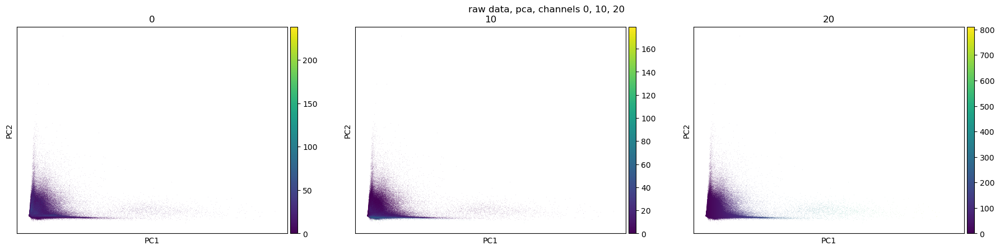

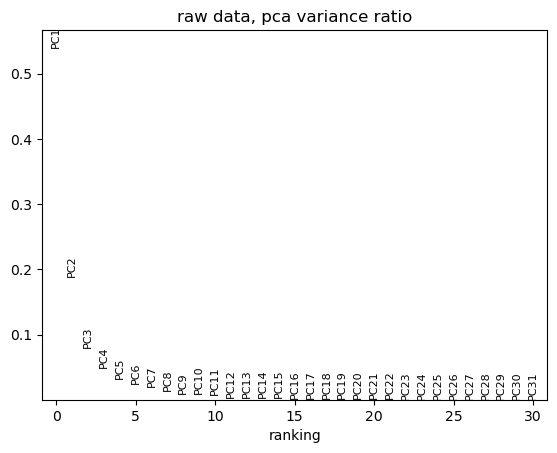

/data/l989o/miniconda3/envs/spatial_uzh_test/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:538: RuntimeWarning:

divide by zero encountered in log



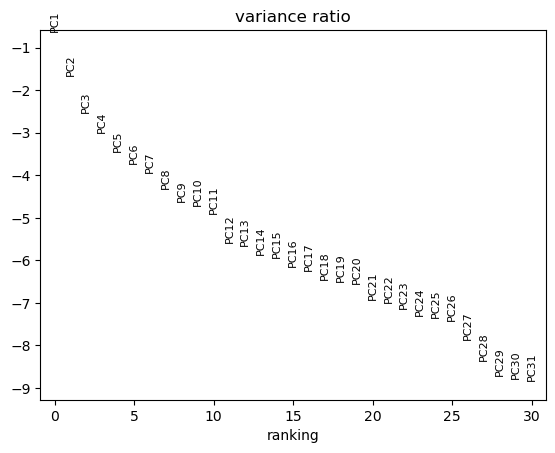

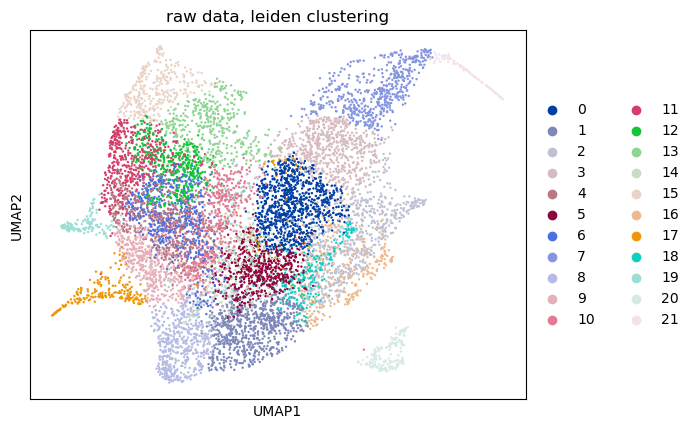

In [82]:
a_train_raw2 = ad.AnnData(t_train_raw2.numpy())
plt.style.use('default')
sc.tl.pca(a_train_raw2, svd_solver='arpack')
sc.pl.pca(a_train_raw2, color=['0', '10', '20'], show=False)
plt.suptitle('raw data, pca, channels 0, 10, 20')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, show=False)
ax = plt.gca()
ax.set_title('raw data, pca variance ratio')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, log=True)

b2 = a_train_raw2[random_choice, :].copy()
sc.pp.neighbors(b2)  #, n_neighbors=10, n_pcs=15)
sc.tl.leiden(b2)  #, resolution=.5)
sc.tl.umap(b2)

sc.pl.umap(b2, color='leiden', show=False)
ax = plt.gca()
ax.set_title('raw data, leiden clustering')
plt.show()

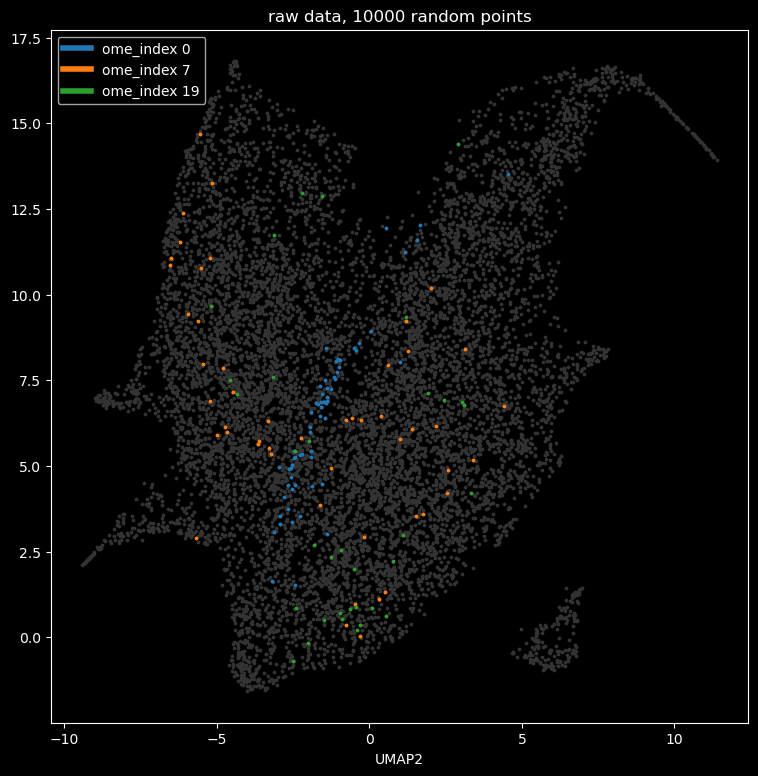

In [81]:
u = b2.obsm['X_umap']
u.shape

import matplotlib
from matplotlib.lines import Line2D

cmap = matplotlib.cm.get_cmap('tab10')

plt.style.use('dark_background')
plt.figure(figsize=(9, 9))
plt.scatter(u[:, 0], u[:, 1], s=3, color=(0.2, 0.2, 0.2, 1.))

for c, ome_index in enumerate([0, 7, 19]):
    index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))
    assert ds.filenames == index_info_omes
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    cool_points = [i for i, j in enumerate(random_choice) if begin <= j <= end]
    x = [u[i, 0] for i in cool_points]
    y = [u[i, 1] for i in cool_points]
    plt.scatter(x, y, s=3, color=cmap.colors[c])

plt.title('raw data, 10000 random points')
plt.xlabel('UMAP1')
plt.xlabel('UMAP2')
custom_lines = [Line2D([0], [0], color=cmap.colors[0], lw=4),
                Line2D([0], [0], color=cmap.colors[1], lw=4),
                Line2D([0], [0], color=cmap.colors[2], lw=4)]
ax = plt.gca()
ax.legend(custom_lines, ['ome_index 0', 'ome_index 7', 'ome_index 19'])
plt.show()
plt.style.use('default')

## transformed data

In [83]:
import math
from tqdm import tqdm
from data import RawMeanDataset

ds = TransformedMeanDataset('train')
list_of_z = []
i = 0
list_of_patient_index = []
for i, x in enumerate(tqdm(ds)):
#    q1 = np.quantile(x0.numpy(), q=0.5, axis=0)
#    if all(q1 < 1e-5):
#        print(i - 1)
#    cofactor = q1 / math.sinh(1)
    ii = torch.tensor([i] * len(x))
#    z = np.arcsinh(x0)
    list_of_z.append(x)
    list_of_patient_index.append(ii)
t_train_raw2 = torch.cat(list_of_z, dim=0)
patient_indexes = torch.cat(list_of_patient_index)

100%|██████████| 226/226 [00:02<00:00, 108.64it/s]


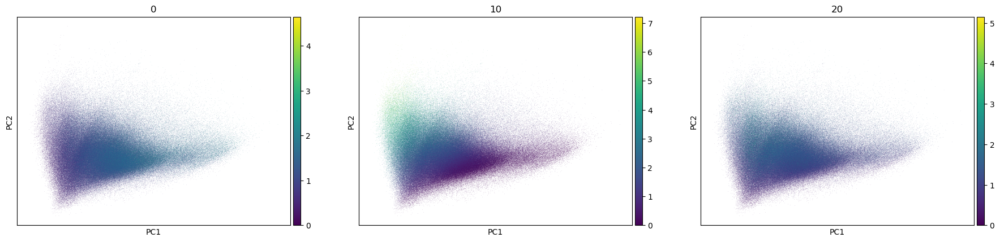

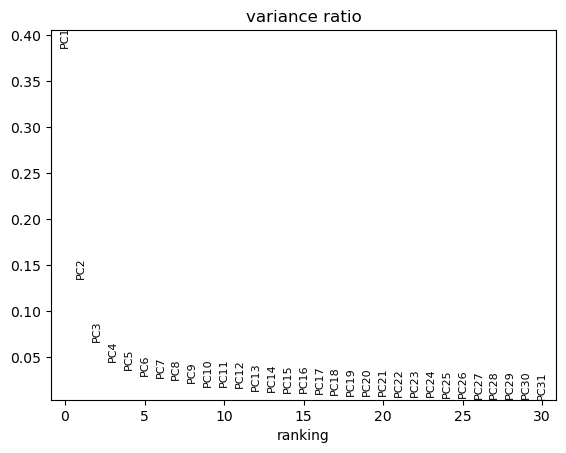

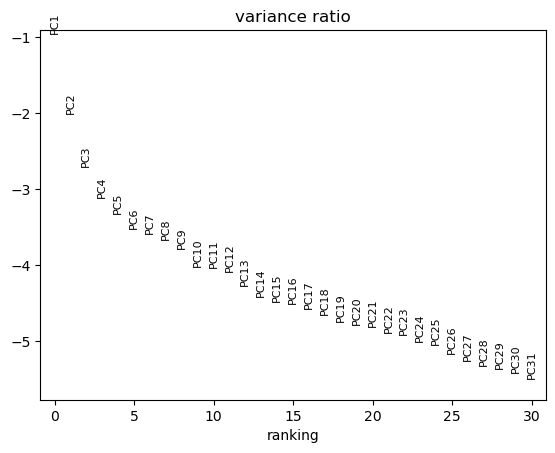

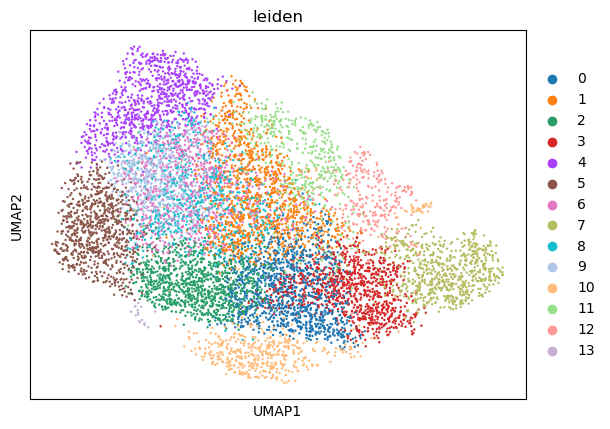

In [84]:
a_train_raw2 = ad.AnnData(t_train_raw2.numpy())
plt.style.use('default')
sc.tl.pca(a_train_raw2, svd_solver='arpack')
sc.pl.pca(a_train_raw2, color=['0', '10', '20'], show=False)
# plt.suptitle('raw data, pca, channels 0, 10, 20')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, show=False)
ax = plt.gca()
# ax.set_title('raw data, pca variance ratio')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, log=True)

b2 = a_train_raw2[random_choice, :].copy()
sc.pp.neighbors(b2)  #, n_neighbors=10, n_pcs=15)
sc.tl.leiden(b2)  #, resolution=.5)
sc.tl.umap(b2)

sc.pl.umap(b2, color='leiden', show=False)
ax = plt.gca()
# ax.set_title('raw data, leiden clustering')
plt.show()

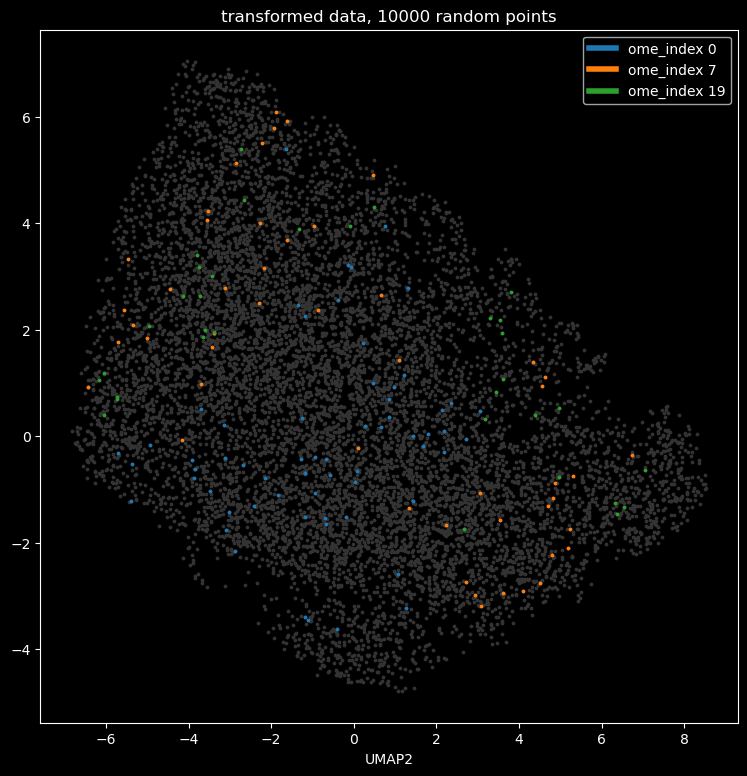

In [85]:
u = b2.obsm['X_umap']
u.shape

import matplotlib
from matplotlib.lines import Line2D

cmap = matplotlib.cm.get_cmap('tab10')

plt.style.use('dark_background')
plt.figure(figsize=(9, 9))
plt.scatter(u[:, 0], u[:, 1], s=3, color=(0.2, 0.2, 0.2, 1.))

for c, ome_index in enumerate([0, 7, 19]):
    index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))
    assert ds.filenames == index_info_omes
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    cool_points = [i for i, j in enumerate(random_choice) if begin <= j <= end]
    x = [u[i, 0] for i in cool_points]
    y = [u[i, 1] for i in cool_points]
    plt.scatter(x, y, s=3, color=cmap.colors[c])

plt.title('transformed data, 10000 random points')
plt.xlabel('UMAP1')
plt.xlabel('UMAP2')
custom_lines = [Line2D([0], [0], color=cmap.colors[0], lw=4),
                Line2D([0], [0], color=cmap.colors[1], lw=4),
                Line2D([0], [0], color=cmap.colors[2], lw=4)]
ax = plt.gca()
ax.legend(custom_lines, ['ome_index 0', 'ome_index 7', 'ome_index 19'])
plt.show()
plt.style.use('default')

## vae mu

In [94]:
print(sinstances[0].all_mu.shape)
print(sinstances[1].all_mu.shape)

(449434, 5)
(449434, 3)


### 3 latent dimensions

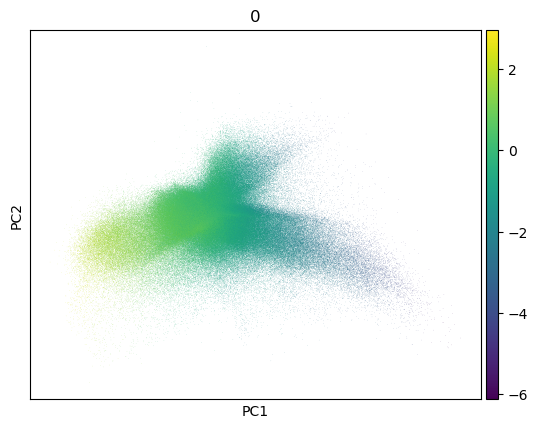

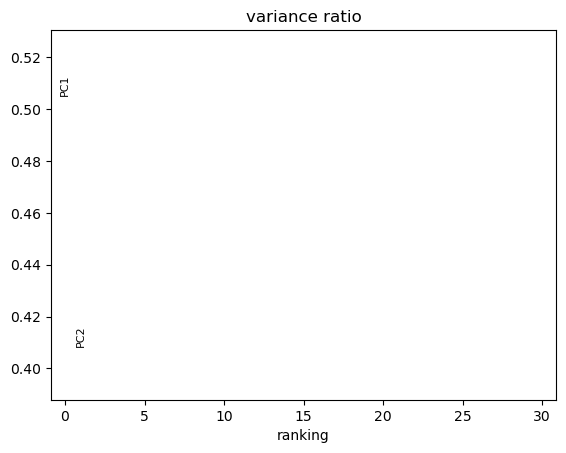

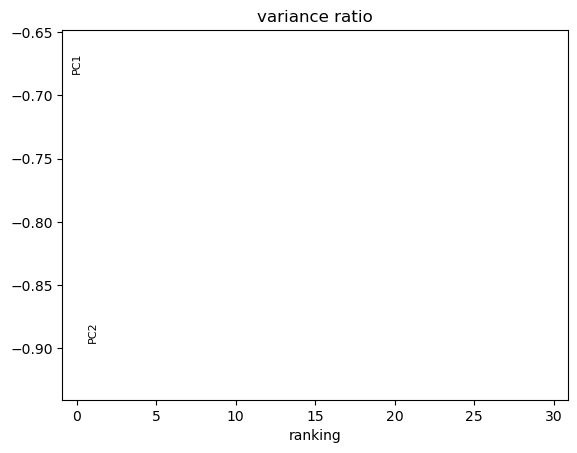

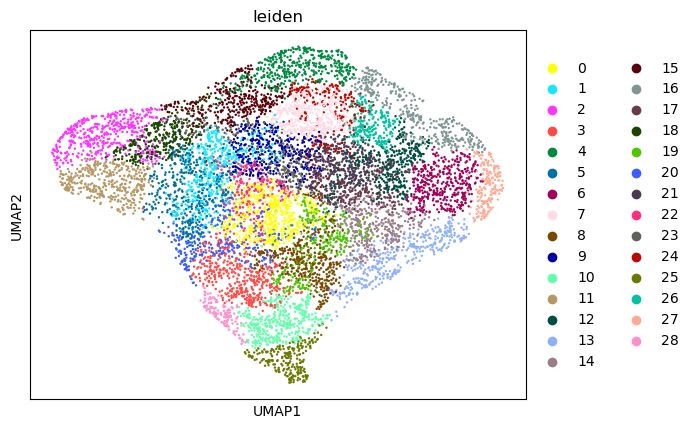

In [102]:
a_train_raw2 = ad.AnnData(sinstances[1].all_mu)
plt.style.use('default')
sc.tl.pca(a_train_raw2, svd_solver='arpack')
sc.pl.pca(a_train_raw2, color=['0'], show=False)
# plt.suptitle('raw data, pca, channels 0, 10, 20')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, show=False)
ax = plt.gca()
# ax.set_title('raw data, pca variance ratio')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, log=True)

b2 = a_train_raw2[random_choice, :].copy()
sc.pp.neighbors(b2)  #, n_neighbors=10, n_pcs=15)
sc.tl.leiden(b2)  #, resolution=.5)
sc.tl.umap(b2)

sc.pl.umap(b2, color='leiden', show=False)
ax = plt.gca()
# ax.set_title('raw data, leiden clustering')
plt.show()

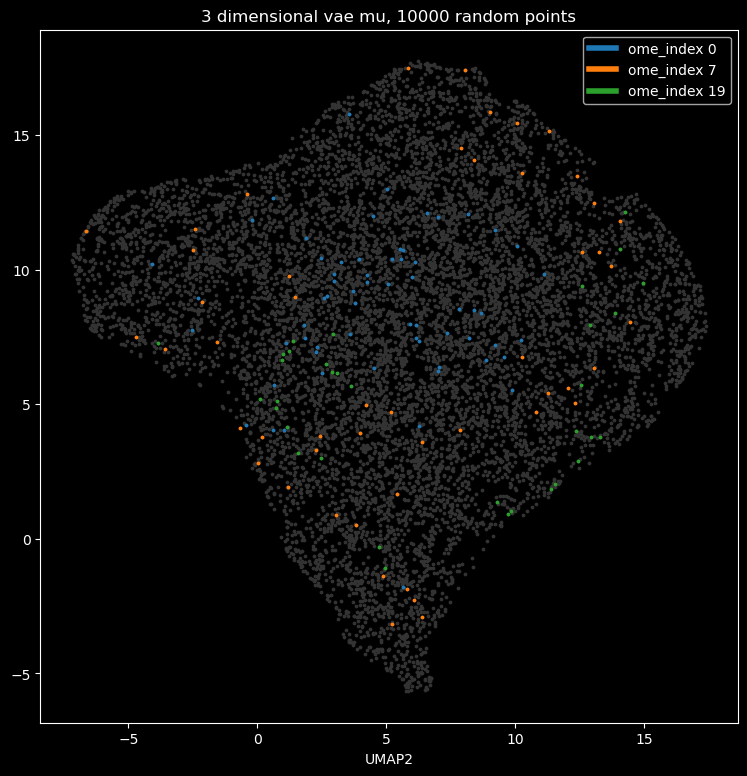

In [103]:
u = b2.obsm['X_umap']
u.shape

import matplotlib
from matplotlib.lines import Line2D

cmap = matplotlib.cm.get_cmap('tab10')

plt.style.use('dark_background')
plt.figure(figsize=(9, 9))
plt.scatter(u[:, 0], u[:, 1], s=3, color=(0.2, 0.2, 0.2, 1.))

for c, ome_index in enumerate([0, 7, 19]):
    index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))
    assert ds.filenames == index_info_omes
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    cool_points = [i for i, j in enumerate(random_choice) if begin <= j <= end]
    x = [u[i, 0] for i in cool_points]
    y = [u[i, 1] for i in cool_points]
    plt.scatter(x, y, s=3, color=cmap.colors[c])

plt.title('3 dimensional vae mu, 10000 random points')
plt.xlabel('UMAP1')
plt.xlabel('UMAP2')
custom_lines = [Line2D([0], [0], color=cmap.colors[0], lw=4),
                Line2D([0], [0], color=cmap.colors[1], lw=4),
                Line2D([0], [0], color=cmap.colors[2], lw=4)]
ax = plt.gca()
ax.legend(custom_lines, ['ome_index 0', 'ome_index 7', 'ome_index 19'])
plt.show()
plt.style.use('default')

### 5 latent dimensions

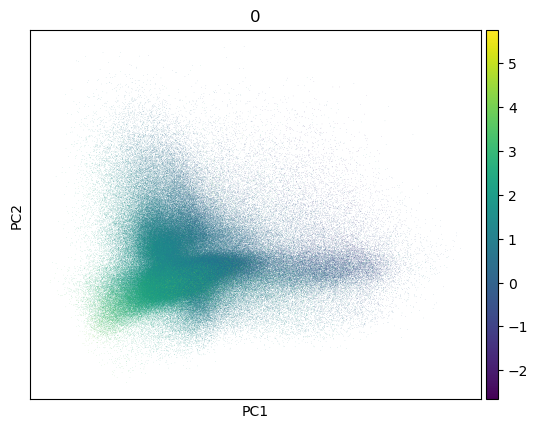

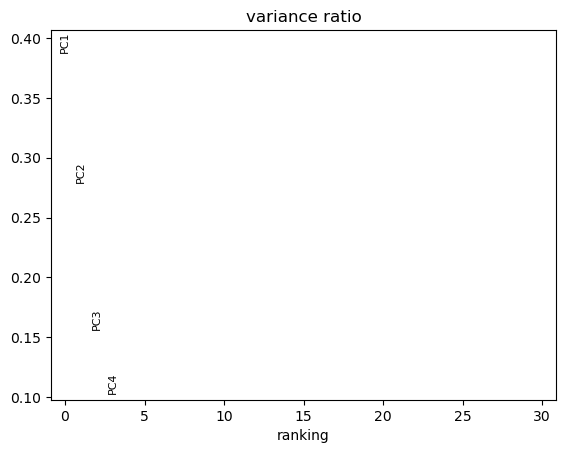

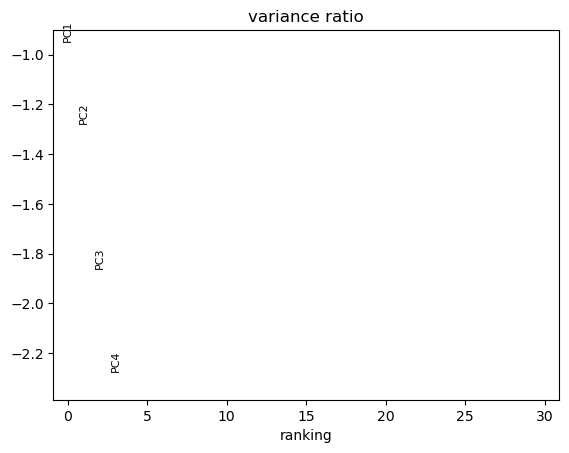

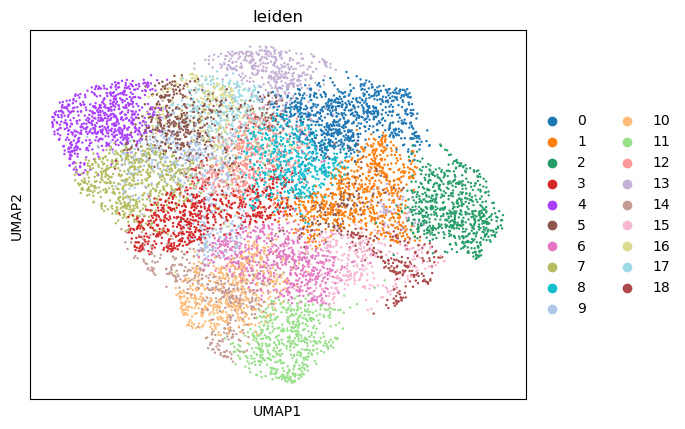

In [99]:
a_train_raw2 = ad.AnnData(sinstances[0].all_mu)
plt.style.use('default')
sc.tl.pca(a_train_raw2, svd_solver='arpack')
sc.pl.pca(a_train_raw2, color=['0'], show=False)
# plt.suptitle('raw data, pca, channels 0, 10, 20')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, show=False)
ax = plt.gca()
# ax.set_title('raw data, pca variance ratio')
plt.show()
sc.pl.pca_variance_ratio(a_train_raw2, log=True)

b2 = a_train_raw2[random_choice, :].copy()
sc.pp.neighbors(b2)  #, n_neighbors=10, n_pcs=15)
sc.tl.leiden(b2)  #, resolution=.5)
sc.tl.umap(b2)

sc.pl.umap(b2, color='leiden', show=False)
ax = plt.gca()
# ax.set_title('raw data, leiden clustering')
plt.show()

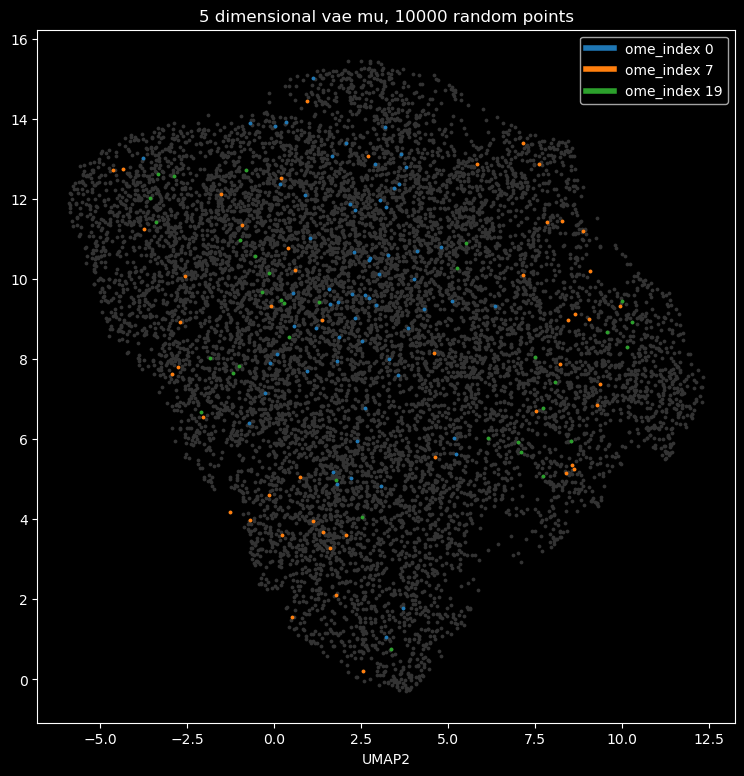

In [101]:
u = b2.obsm['X_umap']
u.shape

import matplotlib
from matplotlib.lines import Line2D

cmap = matplotlib.cm.get_cmap('tab10')

plt.style.use('dark_background')
plt.figure(figsize=(9, 9))
plt.scatter(u[:, 0], u[:, 1], s=3, color=(0.2, 0.2, 0.2, 1.))

for c, ome_index in enumerate([0, 7, 19]):
    index_info_omes, index_info_begins, index_info_ends = pickle.load(open(file_path('merged_cells_info.pickle'), 'rb'))
    assert ds.filenames == index_info_omes
    begin = index_info_begins[ome_index]
    end = index_info_ends[ome_index]
    cool_points = [i for i, j in enumerate(random_choice) if begin <= j <= end]
    x = [u[i, 0] for i in cool_points]
    y = [u[i, 1] for i in cool_points]
    plt.scatter(x, y, s=3, color=cmap.colors[c])

plt.title('5 dimensional vae mu, 10000 random points')
plt.xlabel('UMAP1')
plt.xlabel('UMAP2')
custom_lines = [Line2D([0], [0], color=cmap.colors[0], lw=4),
                Line2D([0], [0], color=cmap.colors[1], lw=4),
                Line2D([0], [0], color=cmap.colors[2], lw=4)]
ax = plt.gca()
ax.legend(custom_lines, ['ome_index 0', 'ome_index 7', 'ome_index 19'])
plt.show()
plt.style.use('default')